In [1]:
import numpy as np
from dicom_loader import DicomDdetector
from torch.utils.data import DataLoader
import torch
from importlib import import_module
from os.path import join as opjoin
from layers_se import *
import matplotlib.pyplot as plt
import math


base_path = '/home/pulyanov/projects/KT/KT_ITMO/3D/'
data_path='/home/pulyanov/projects/KT/KT_ITMO/3D/luna_detector/data/preprocess-result-path'
model = import_module('res18_se')
config, net, loss, get_pbb = model.get_model()
net = net.cuda()
thr = -0.5
luna_path = opjoin(base_path, 'luna_detector')
checkpoint = torch.load(opjoin(luna_path, 'test_results', 'detector_122.ckpt'))
net.load_state_dict(checkpoint['state_dict'])
gp = GetPBB(config)

def test_img(imgs):
    
    dataset = DicomDdetector(imgs) 
    data_loader = DataLoader(dataset, batch_size=1, shuffle=False, num_workers=1,
                             pin_memory=False)
    
    for i, tpl in enumerate(data_loader):
            
        data = torch.autograd.Variable(tpl[0].cuda())
        coord = torch.autograd.Variable(tpl[1].cuda())
        print("!!!!", data.shape, coord.shape)
        data = data.type(torch.cuda.FloatTensor)
        coord = coord.type(torch.cuda.FloatTensor)
        output = net(data, coord)
        pred = gp(output.cpu().detach().numpy()[0], thr)
        print("pred", pred)
        fig,ax = plt.subplots(8, 8, figsize=(20,20))
        zPlain = 0
        for i in range (8):
            for k in range (8):
                img = tpl[0].cuda()[0][0][zPlain].cpu().detach().numpy()
                #coord = tpl[1].cuda()[0][0][zPlain].cpu().detach().numpy()
                #print("coord", coord)
                xS = 0
                yS = 0
                zS = 0
                rS = 0
                for pr in pred:
                    nPred = 1
                    x = pr[3]
                    y = pr[2]
                    z = pr[1]
                    r = pr[4]
                    xS += x
                    yS += y
                    zS += z
                    rS += r 
                if (len(pred)>0):
                    xS /= len(pred)
                    yS /= len(pred)
                    zS /= len(pred)
                    rS /= len(pred)
                
                dz = zS - zPlain
                r2 = rS * rS - dz * dz
                if r2 > 0:
                    r = math.sqrt(r2)
                    circle = plt.Circle((xS, yS), r, color='r', fill=False)
                    ax[i, k].add_artist(circle)
                zPlain += 1
                ax[i, k].imshow(img)
        
        plt.show()

    

FOCAL LOSS 2 0.5


img (1, 313, 240, 322)
start [[64, 64, 64], [64, 64, 128], [64, 64, 192], [64, 64, 256], [64, 64, 258], [64, 128, 64], [64, 128, 128], [64, 128, 192], [64, 128, 256], [64, 128, 258], [64, 176, 64], [64, 176, 128], [64, 176, 192], [64, 176, 256], [64, 176, 258], [128, 64, 64], [128, 64, 128], [128, 64, 192], [128, 64, 256], [128, 64, 258], [128, 128, 64], [128, 128, 128], [128, 128, 192], [128, 128, 256], [128, 128, 258], [128, 176, 64], [128, 176, 128], [128, 176, 192], [128, 176, 256], [128, 176, 258], [192, 64, 64], [192, 64, 128], [192, 64, 192], [192, 64, 256], [192, 64, 258], [192, 128, 64], [192, 128, 128], [192, 128, 192], [192, 128, 256], [192, 128, 258], [192, 176, 64], [192, 176, 128], [192, 176, 192], [192, 176, 256], [192, 176, 258], [249, 64, 64], [249, 64, 128], [249, 64, 192], [249, 64, 256], [249, 64, 258], [249, 128, 64], [249, 128, 128], [249, 128, 192], [249, 128, 256], [249, 128, 258], [249, 176, 64], [249, 176, 128], [249, 176, 192], [249, 176, 256], [249, 176, 258

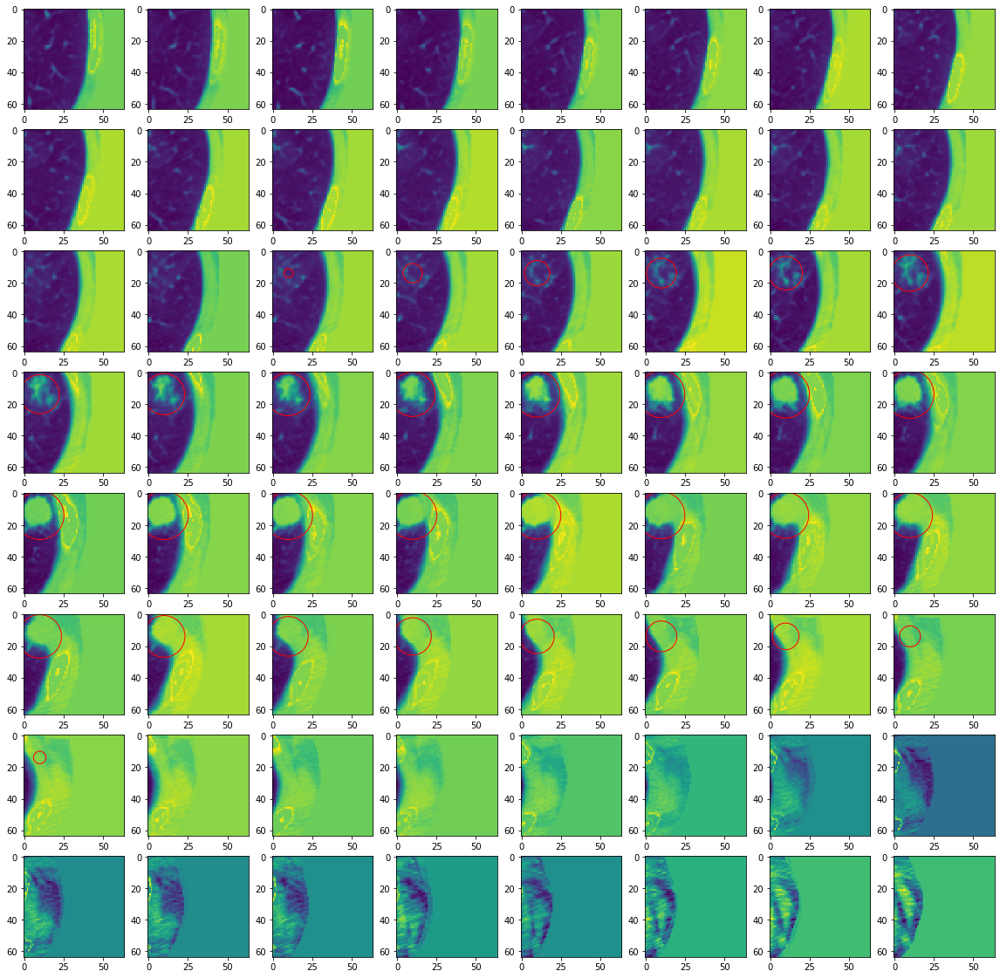

idx 3
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.25525665 29.05247    14.036621   10.365139   12.97254   ]
 [-0.25329447 29.378878   12.886866    9.628646   17.489508  ]
 [ 0.38057232 32.85327    14.1576605   9.914427   12.543897  ]
 [ 0.4174919  32.841656   13.273488    9.167105   17.815369  ]]


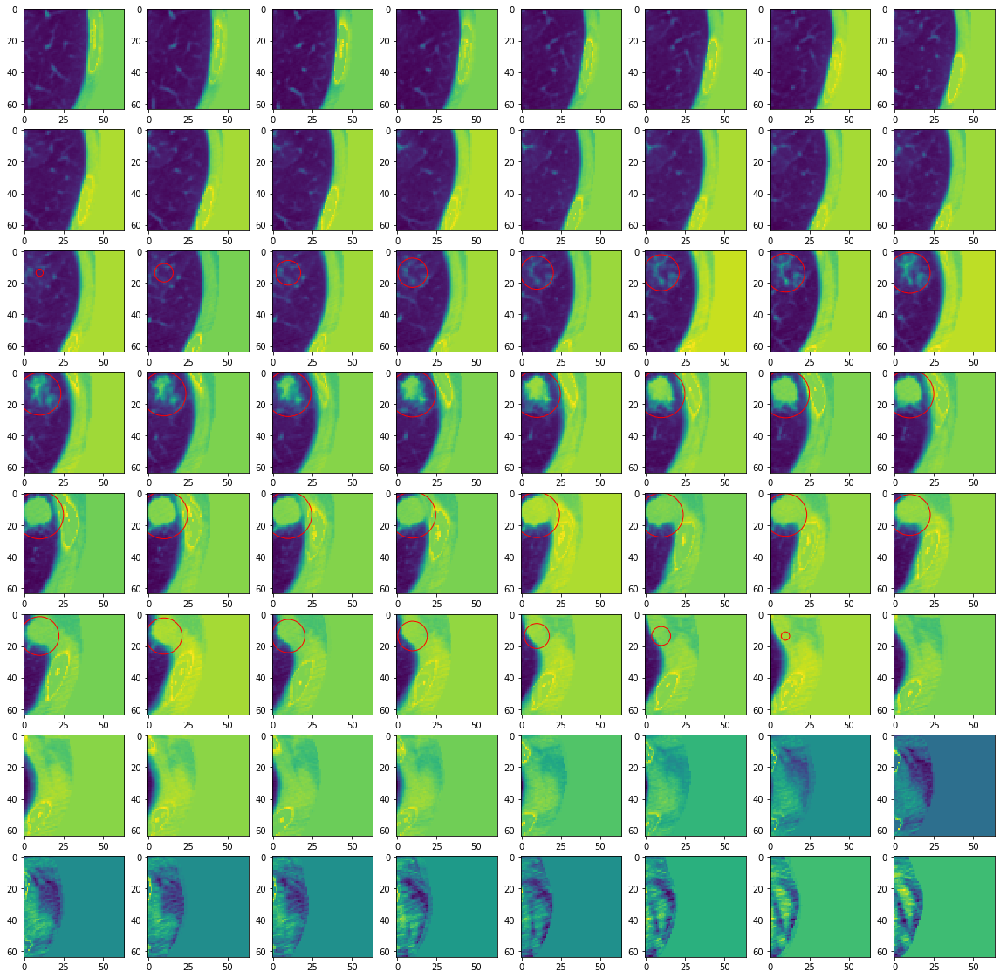

idx 4
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


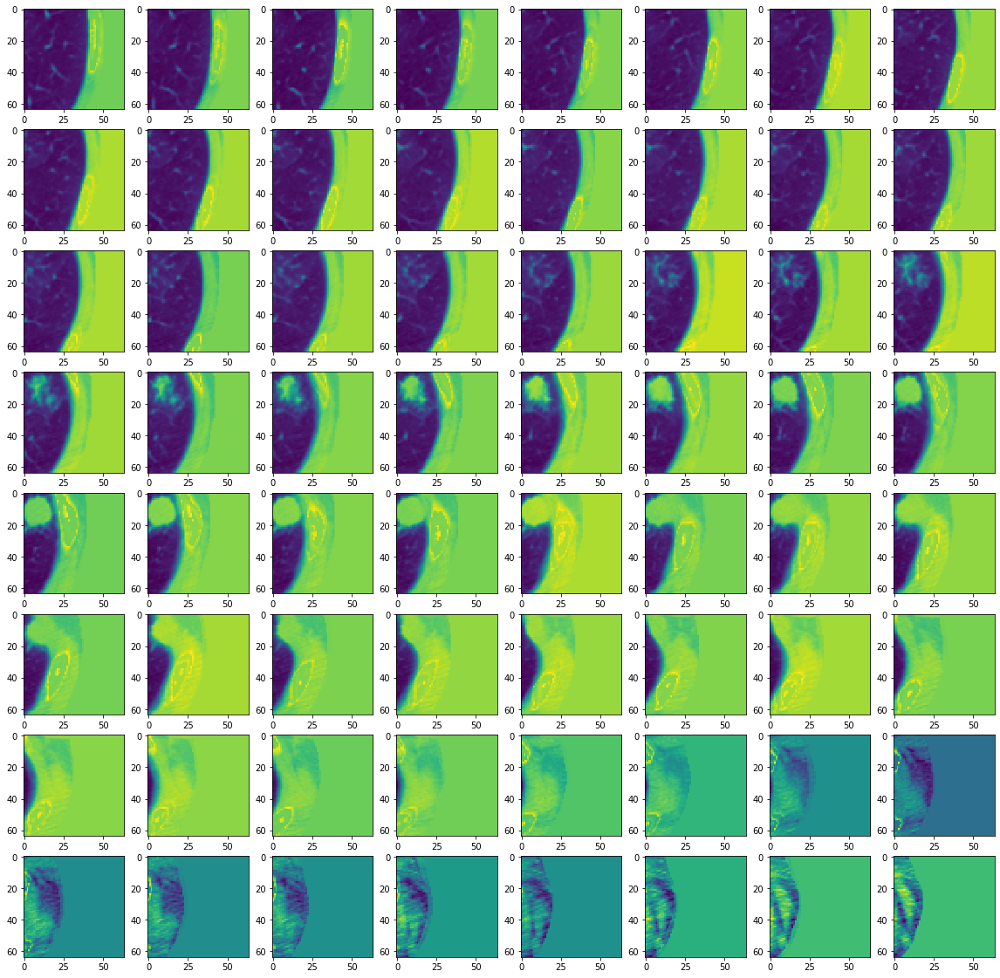

idx 5
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.39209318 29.335773    9.777562    9.7587805  11.856575  ]
 [-0.4971993  29.594145   13.562131    9.930594   12.614411  ]
 [-0.34720802 29.755491   13.455051    9.8059635  16.907251  ]]


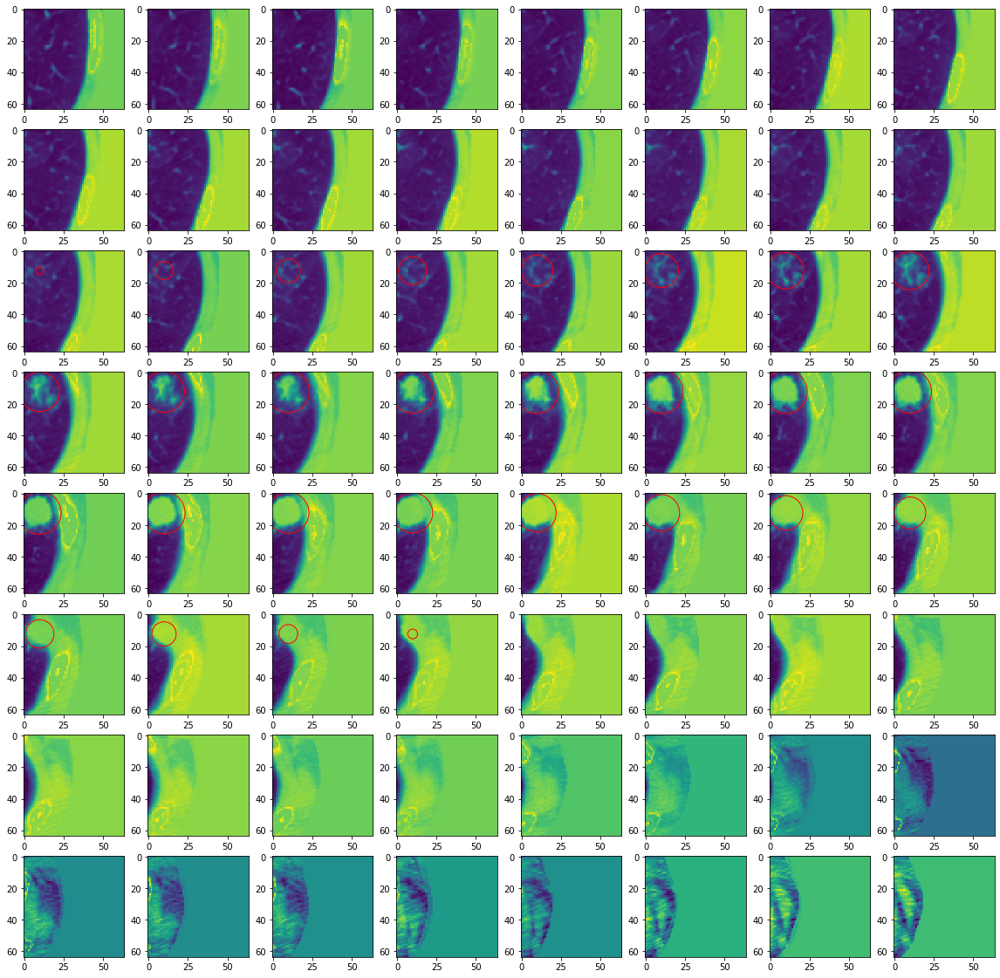

idx 6
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.05609274 26.167246    9.216308    9.605342   11.647274  ]
 [-0.48016834 26.166101   13.257481    9.518889   11.067444  ]
 [ 0.0599575  29.269352    9.21071     9.749255   12.820757  ]
 [ 0.5024862  29.526684   13.433551    9.676606   12.254     ]
 [ 0.09194946 29.673708   13.229647    9.410827   16.546083  ]
 [ 0.21291876 33.00315    13.748449    9.436046   12.5167265 ]
 [ 0.35500383 32.803852   13.500504    9.012376   16.992697  ]]


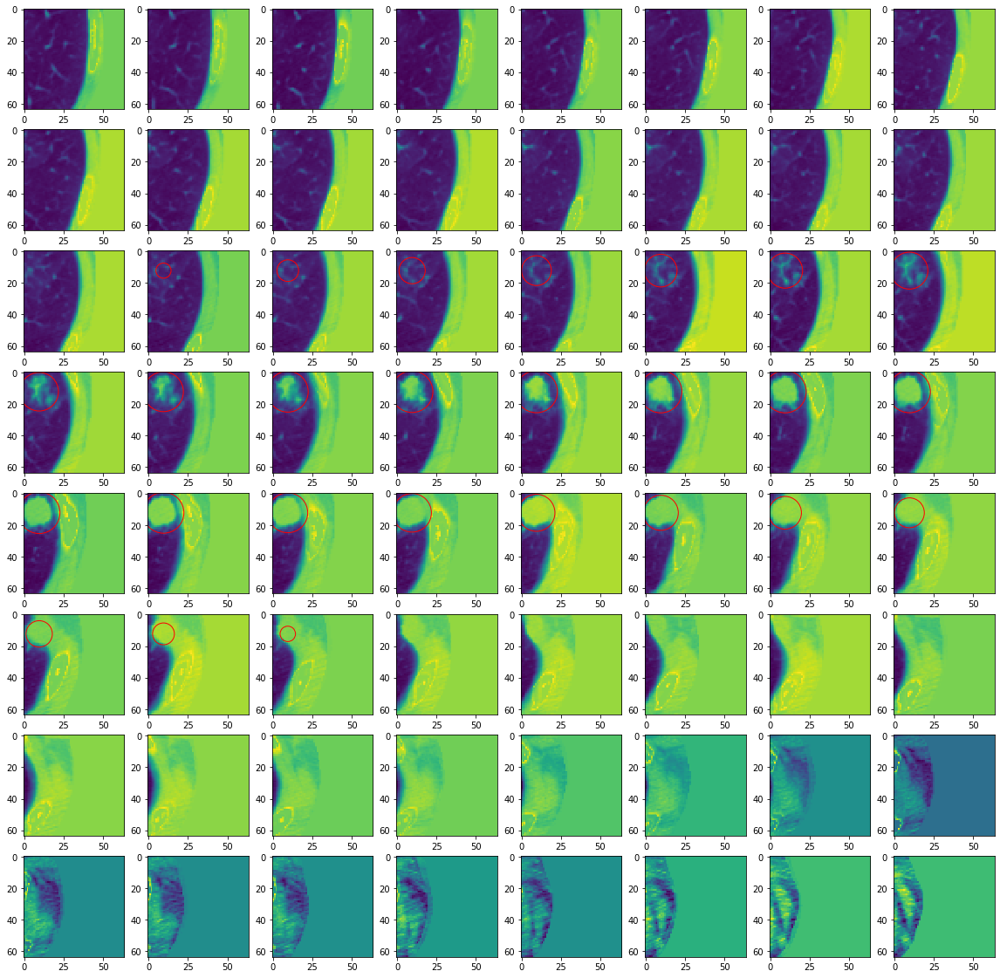

idx 7
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


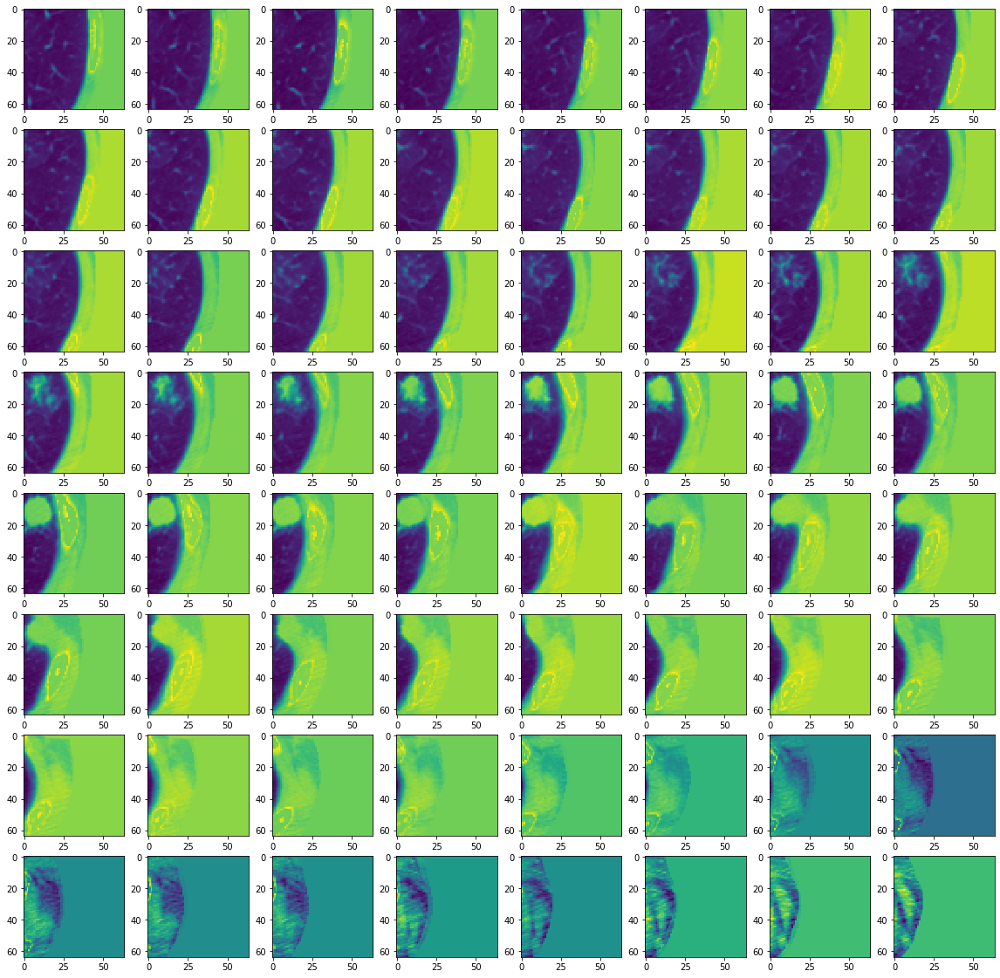

idx 8
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.45557094 29.290668   13.664661    9.121205   17.731306  ]]


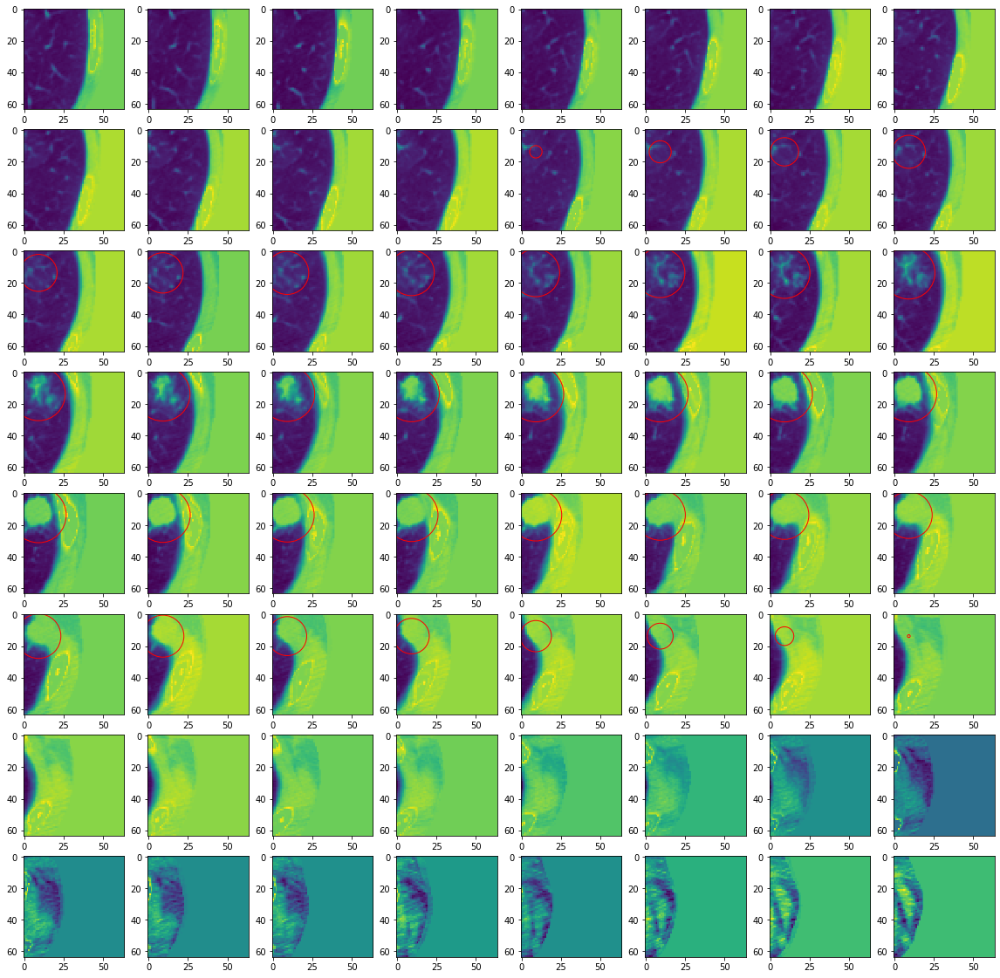

idx 9
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.15178919 29.568344    9.210047   10.081739   12.223816  ]
 [-0.28647995 29.92865     8.60286     9.542501   16.543083  ]
 [-0.12665367 29.325525   13.540858    9.515348   11.501082  ]
 [ 0.29133797 29.230896   13.197068    8.956724   17.220196  ]
 [ 0.04283524 32.85745    12.567497    8.635728   16.812008  ]]


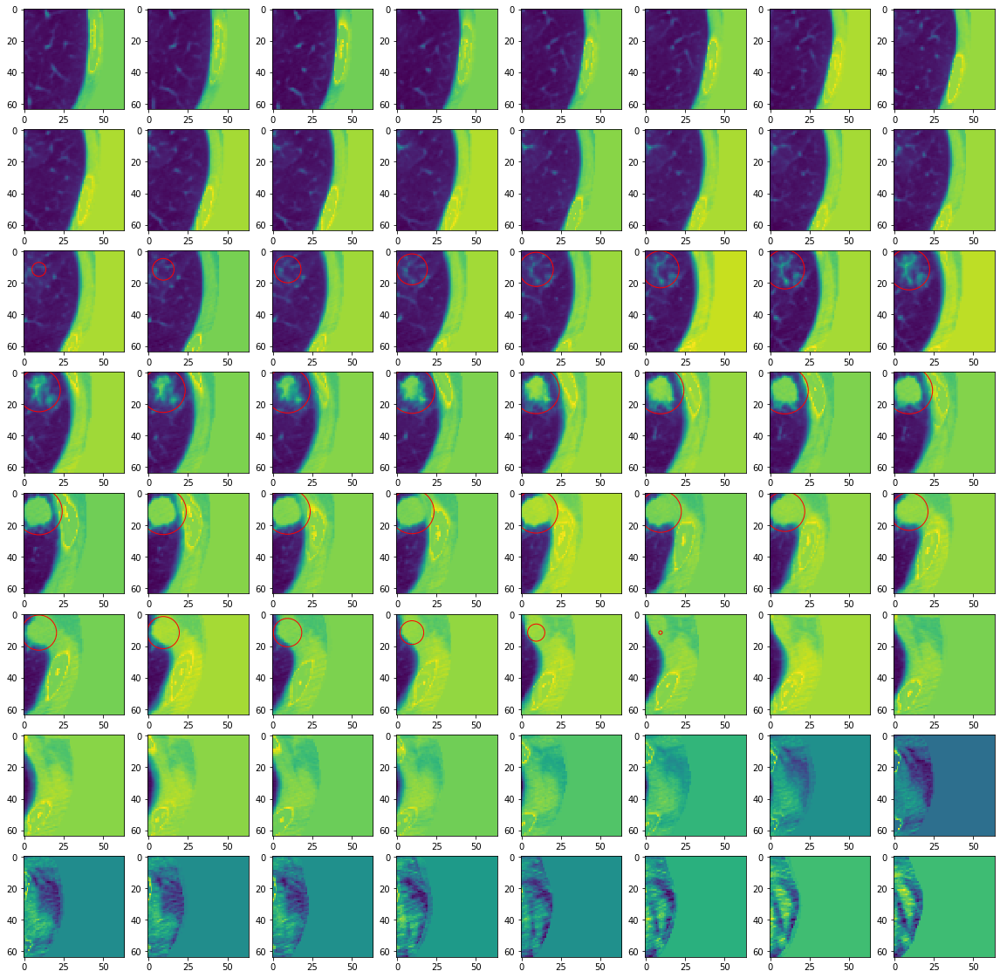

idx 10
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4024539  26.350508    9.26838    10.13039    11.122604  ]
 [-0.21665859 29.340624    9.523953    9.774283   12.847438  ]
 [-0.2345624  29.697536   13.504016    9.595738   12.36355   ]
 [-0.21212912 29.864674   13.57729     9.573769   16.500696  ]
 [-0.24813223 33.3163     13.611005    9.451401   12.127476  ]
 [-0.1469984  33.16816    13.610685    9.190312   17.046642  ]]


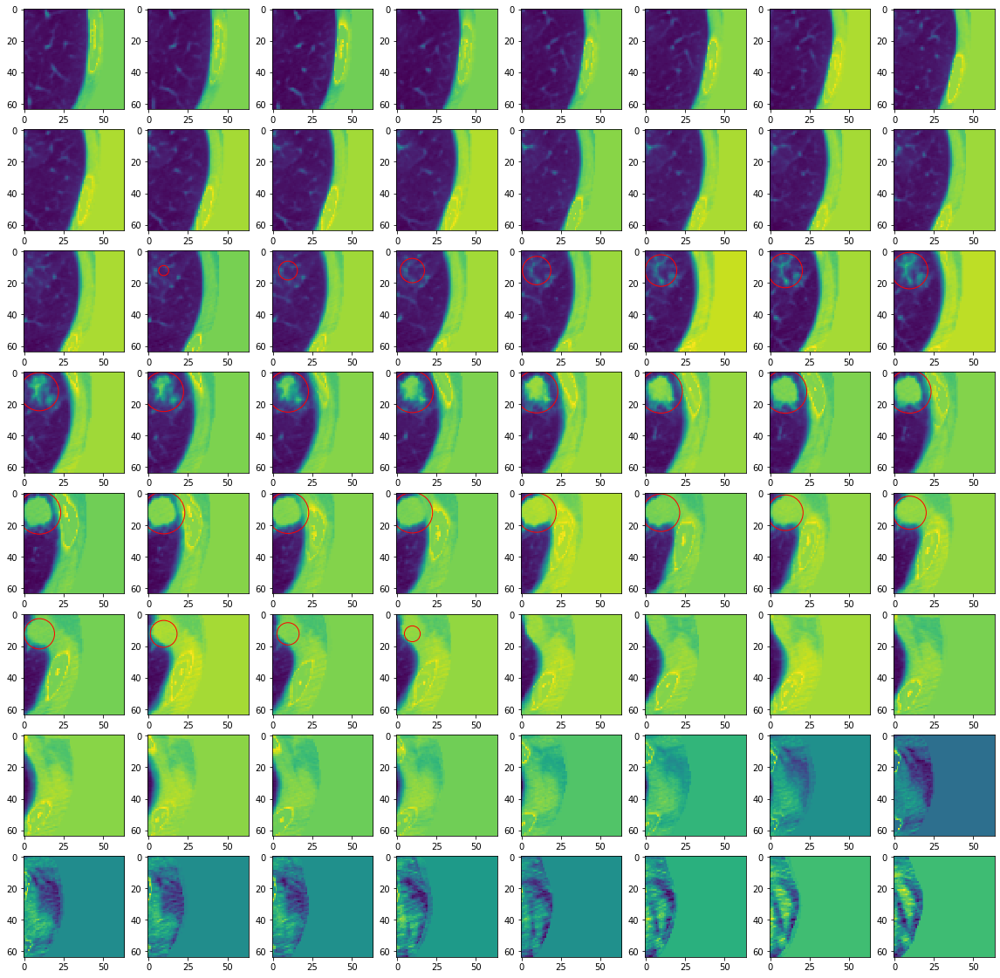

idx 11
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.37428546 29.23476    13.818367    9.92349    11.779734  ]
 [-0.3757763  29.283962   13.655851    9.821423   15.971141  ]]


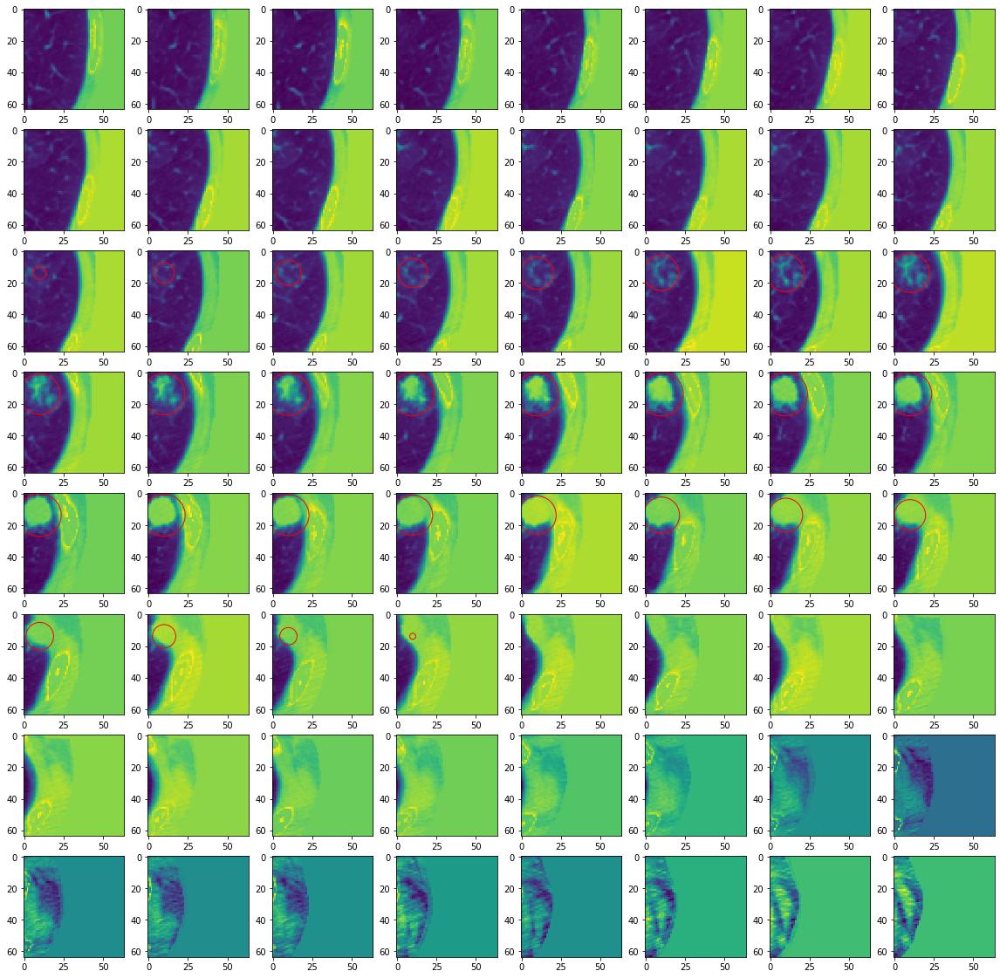

idx 12
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.39800215 26.510838    9.441199    9.094214    9.9973955 ]]


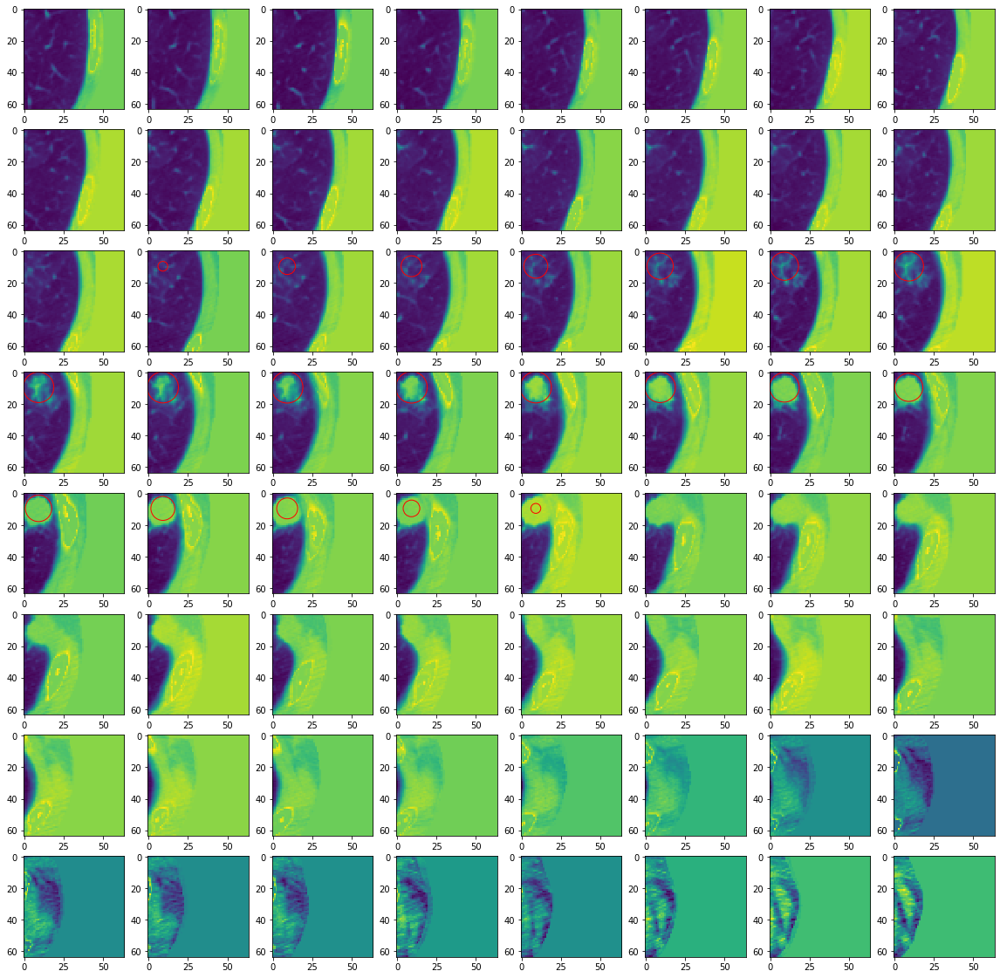

idx 13
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.46166348 32.835728   13.227566    9.0008335  18.273867  ]]


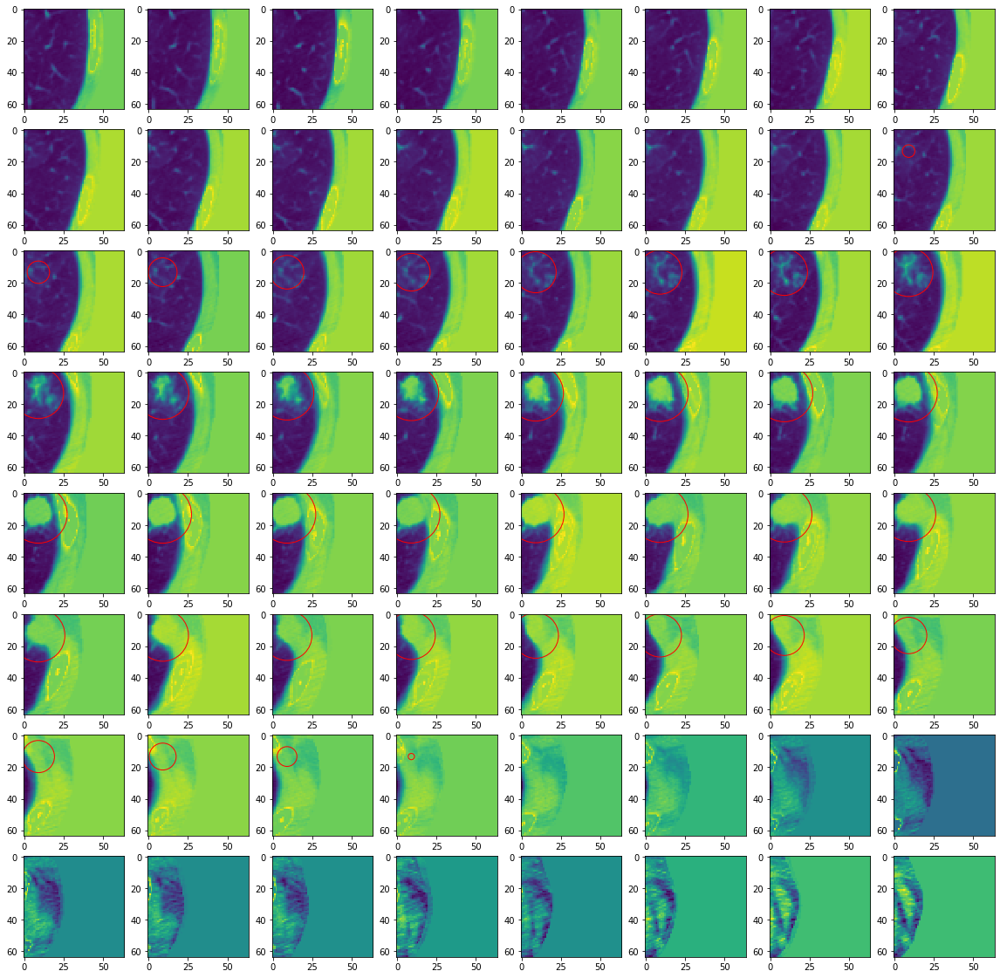

idx 14
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.32733727 25.498257   13.431137    9.115948   17.555632  ]
 [-0.23252153 29.109964    9.509585    9.288625   12.1737995 ]
 [ 0.22319269 28.976751    9.6108885   9.155548   17.04655   ]
 [-0.29845858 28.846512   13.240634    5.1295857  17.935398  ]
 [ 0.05191851 29.272034   13.653197    9.522733   12.411926  ]
 [ 1.1515551  29.169846   13.595674    9.272284   16.950949  ]
 [ 0.76863813 32.690678   13.864051    9.449331   12.975115  ]
 [ 1.8700409  32.491024   13.393043    8.889762   16.867754  ]]


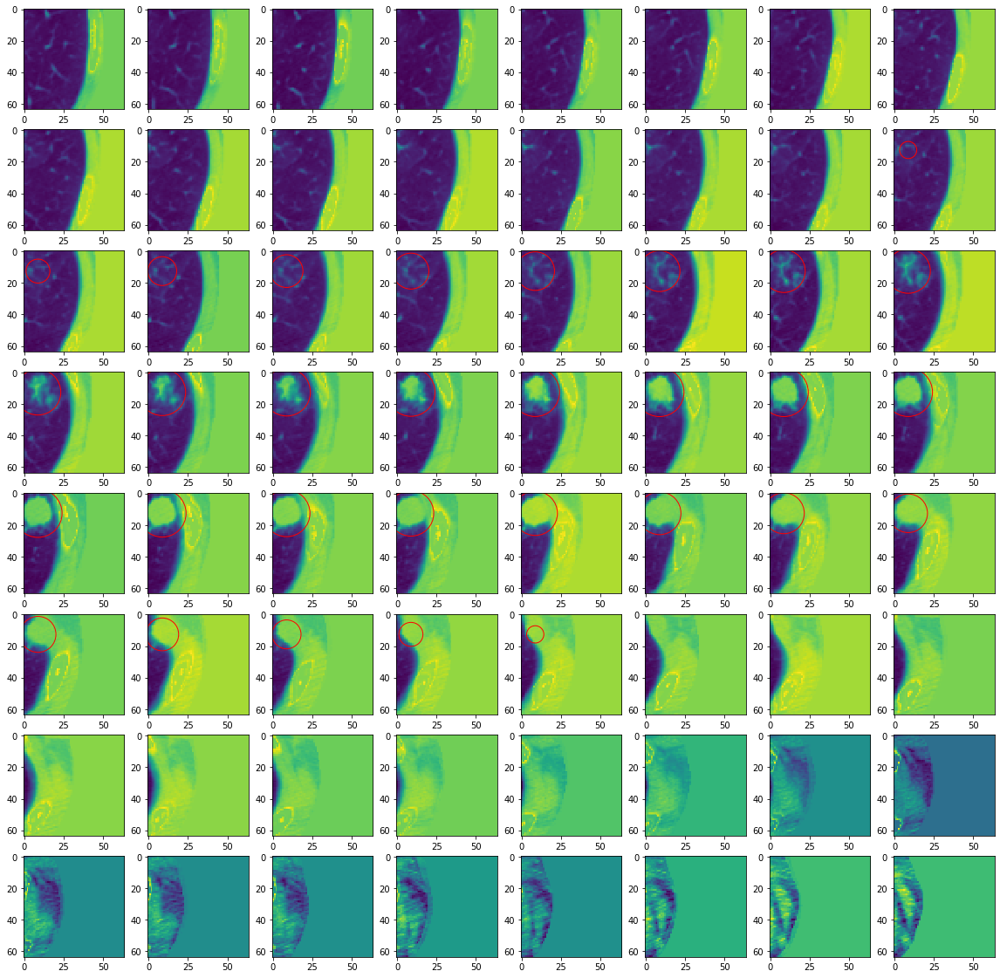

idx 15
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


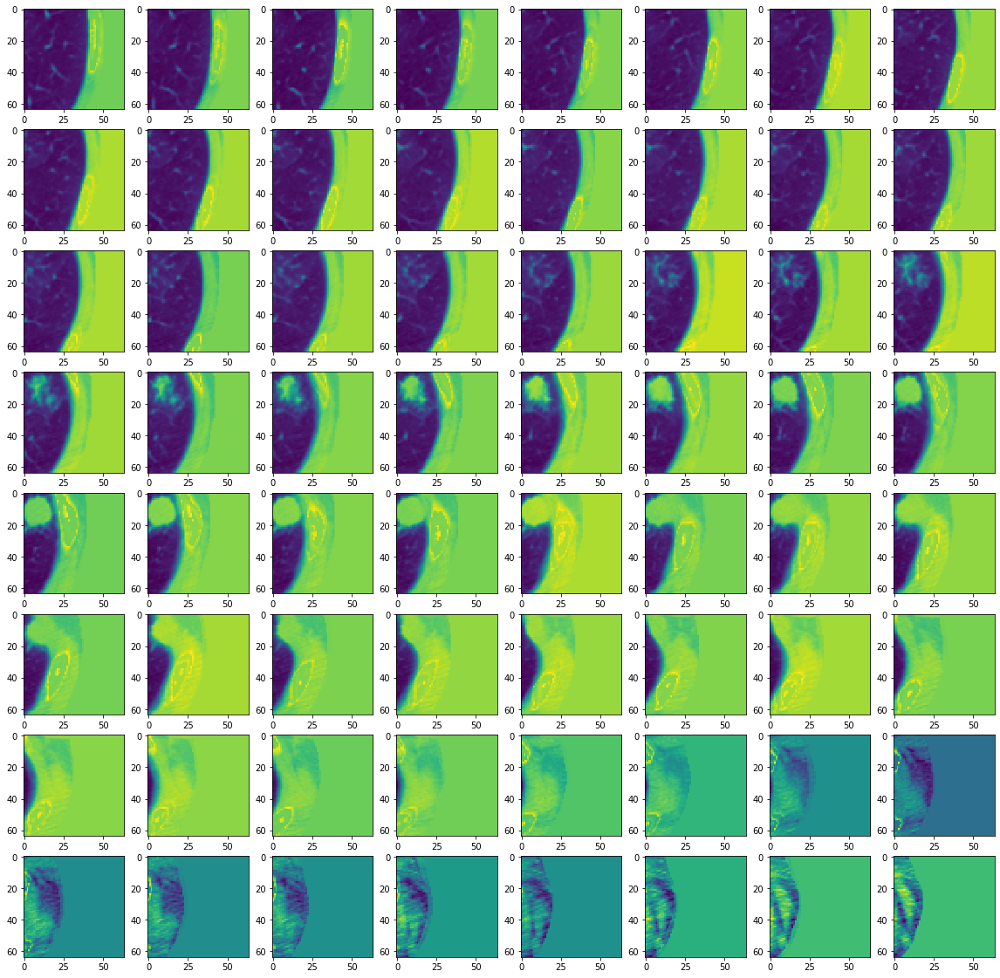

idx 16
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.21555662 29.44958    13.169101    9.328512   16.591368  ]
 [ 0.8529577  32.33809    12.828543    8.695415   16.838783  ]]


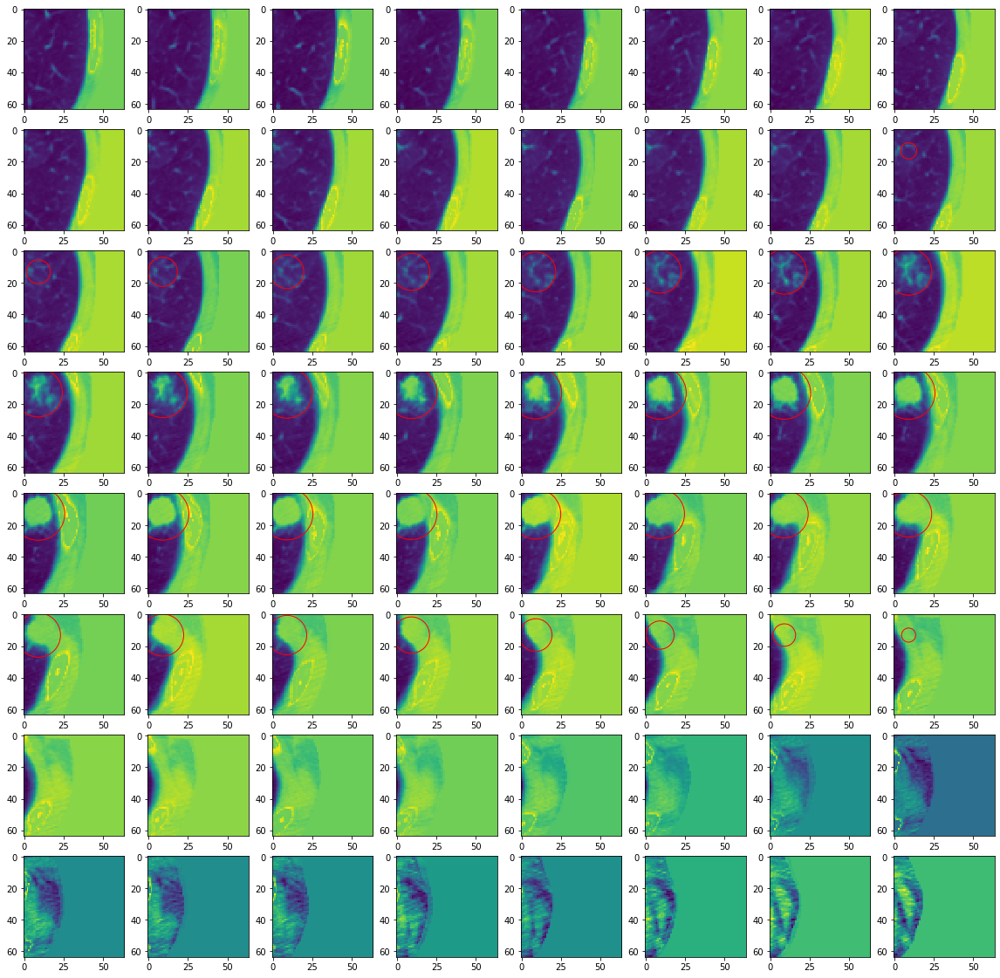

idx 17
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.23876    29.331741   13.449554    9.6147585  11.932116  ]
 [-0.45594096 29.34155    13.087547    9.124263   16.82574   ]]


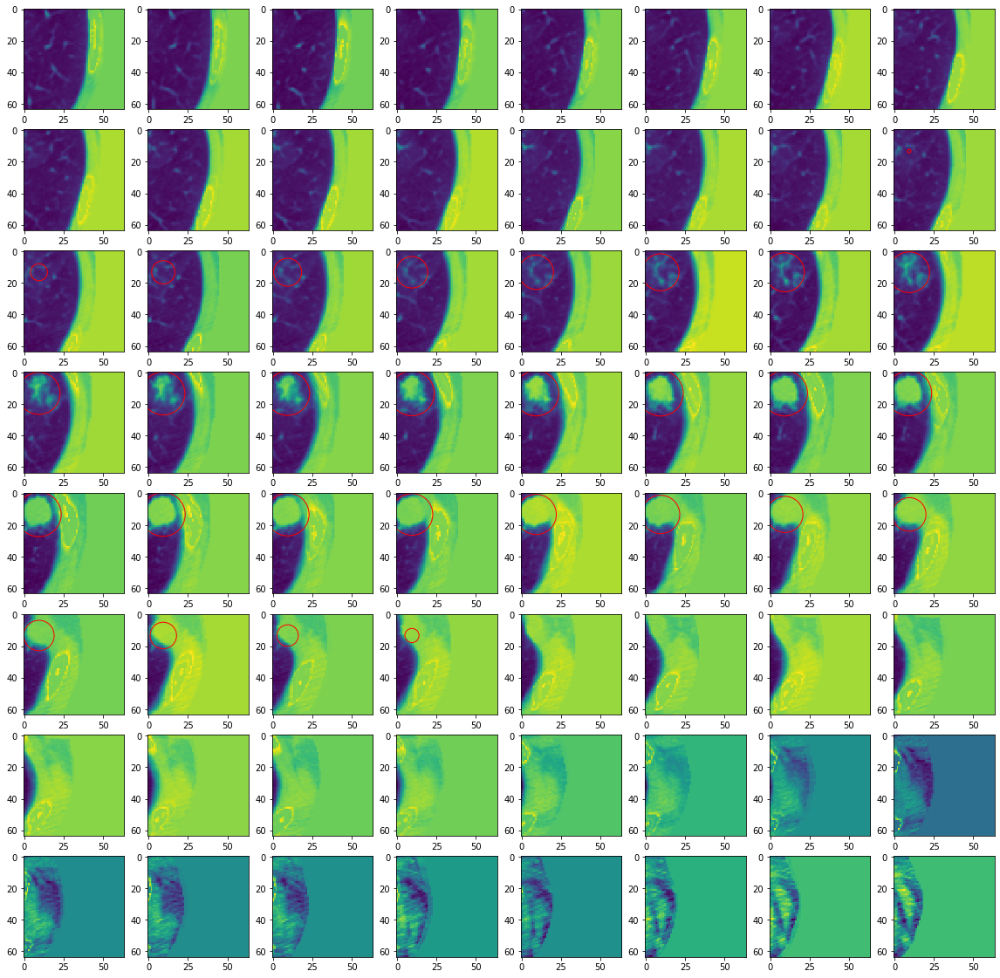

idx 18
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


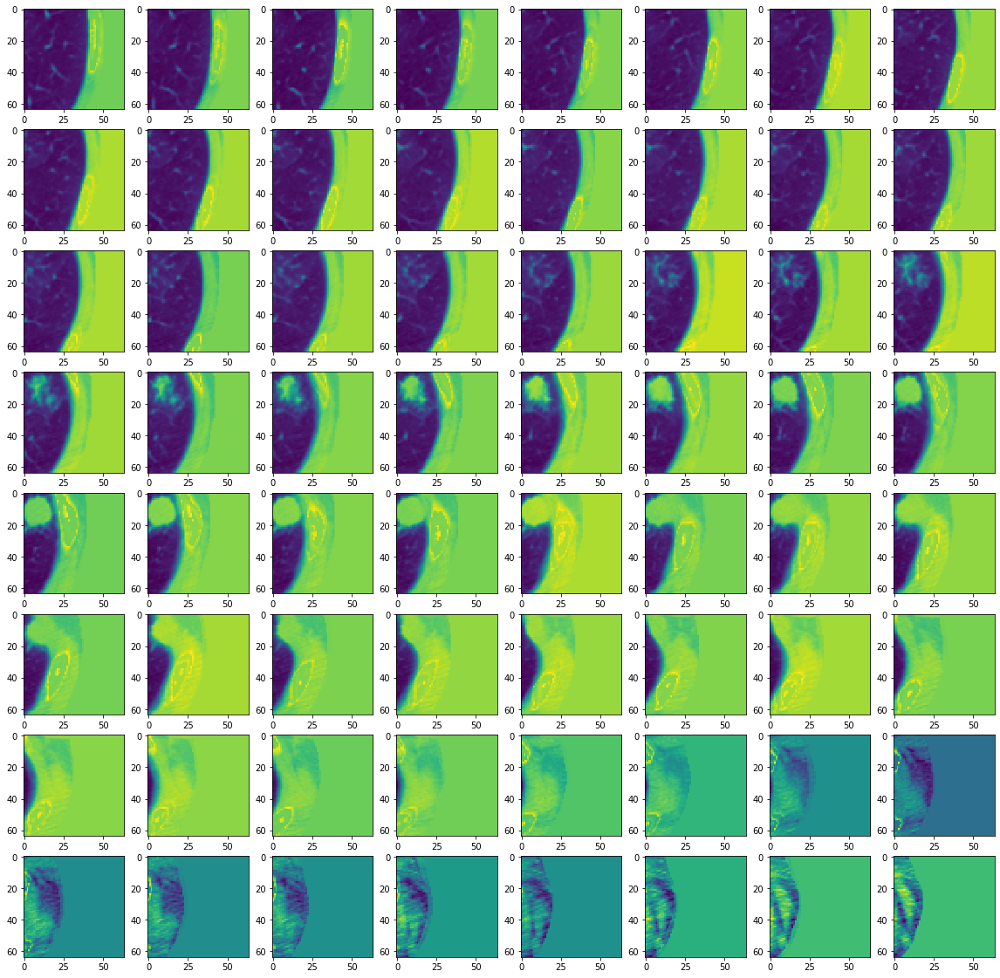

idx 19
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


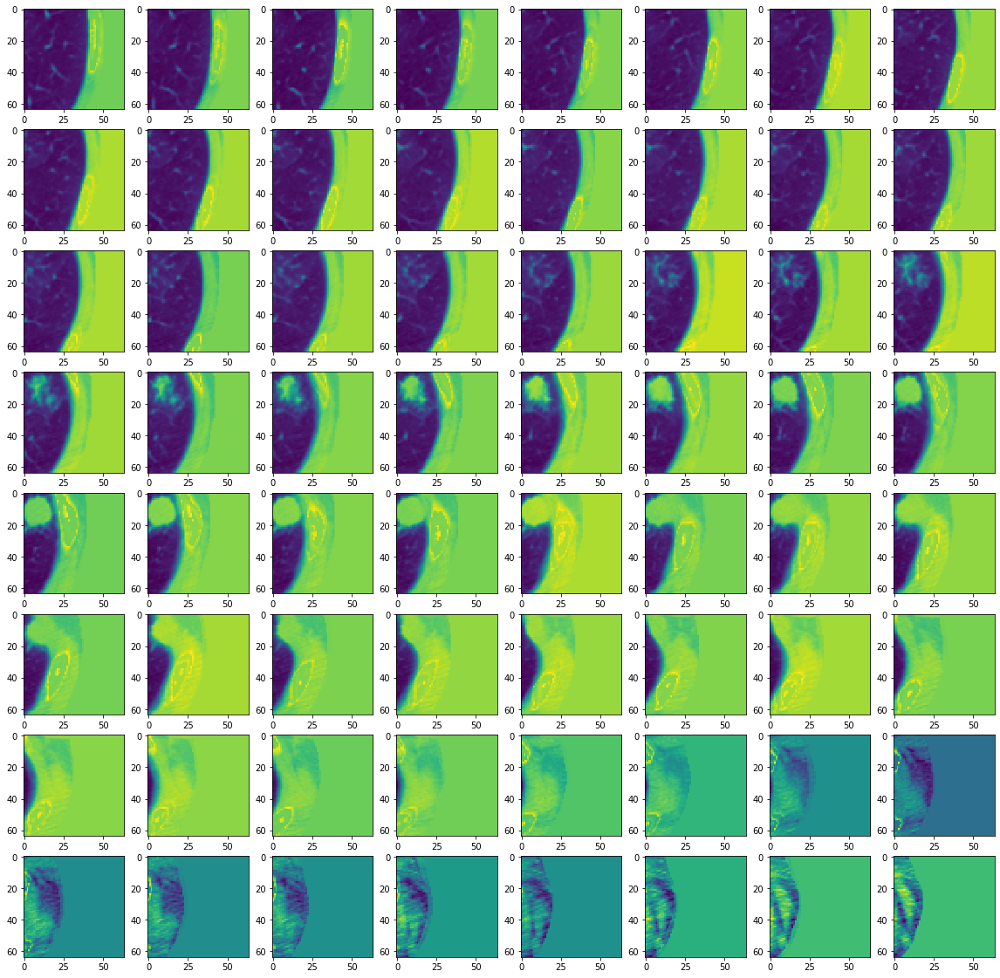

idx 20
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


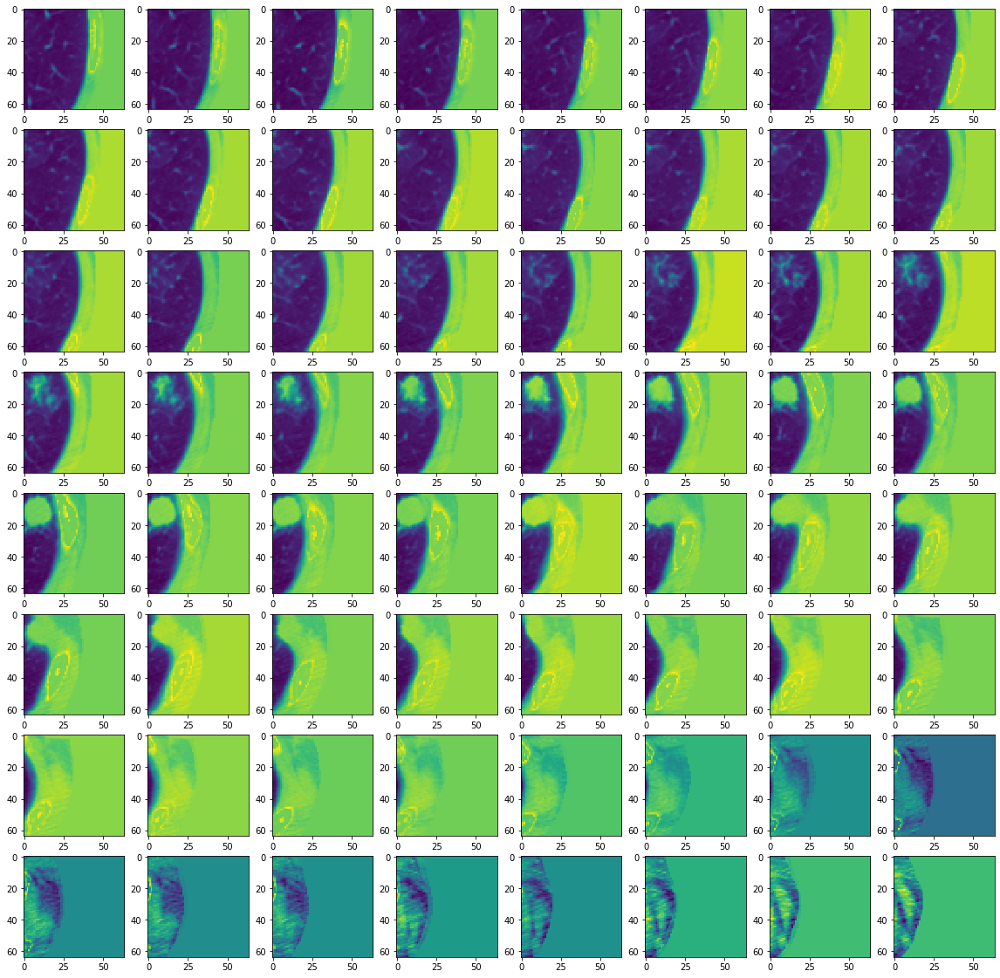

idx 21
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-2.8669071e-01  2.9767086e+01  9.6537142e+00  9.9454632e+00
   1.2571392e+01]
 [-2.8825617e-01  2.9727194e+01  9.7029705e+00  1.0019939e+01
   1.7262878e+01]
 [ 1.9806385e-02  2.9696287e+01  1.3783463e+01  9.7357378e+00
   1.7633955e+01]
 [-2.0789385e-01  3.3297169e+01  1.3895312e+01  9.8558321e+00
   1.2167599e+01]
 [ 3.7865353e-01  3.3304382e+01  1.3474778e+01  9.4130545e+00
   1.7665026e+01]]


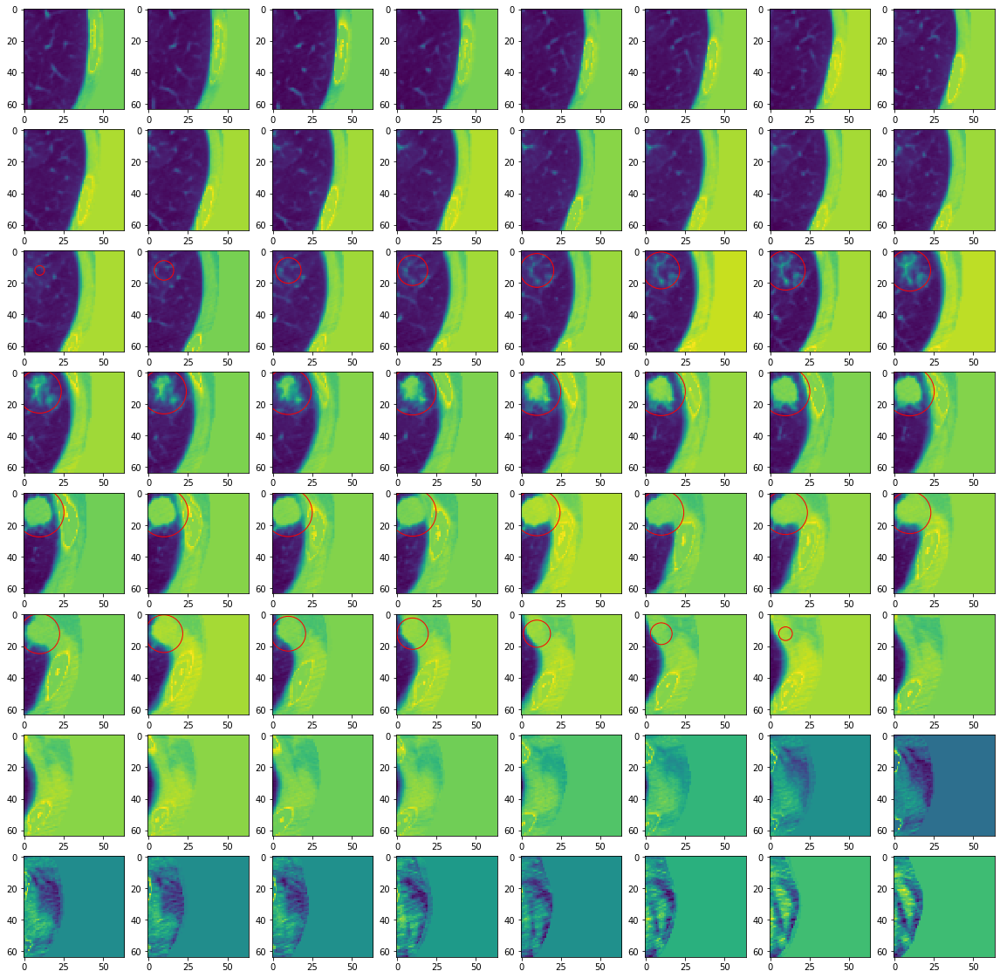

idx 22
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.3609271  29.577143   13.733187    9.4581175  16.777441  ]
 [-0.06991339 33.90941    13.804688    9.804331   16.129377  ]]


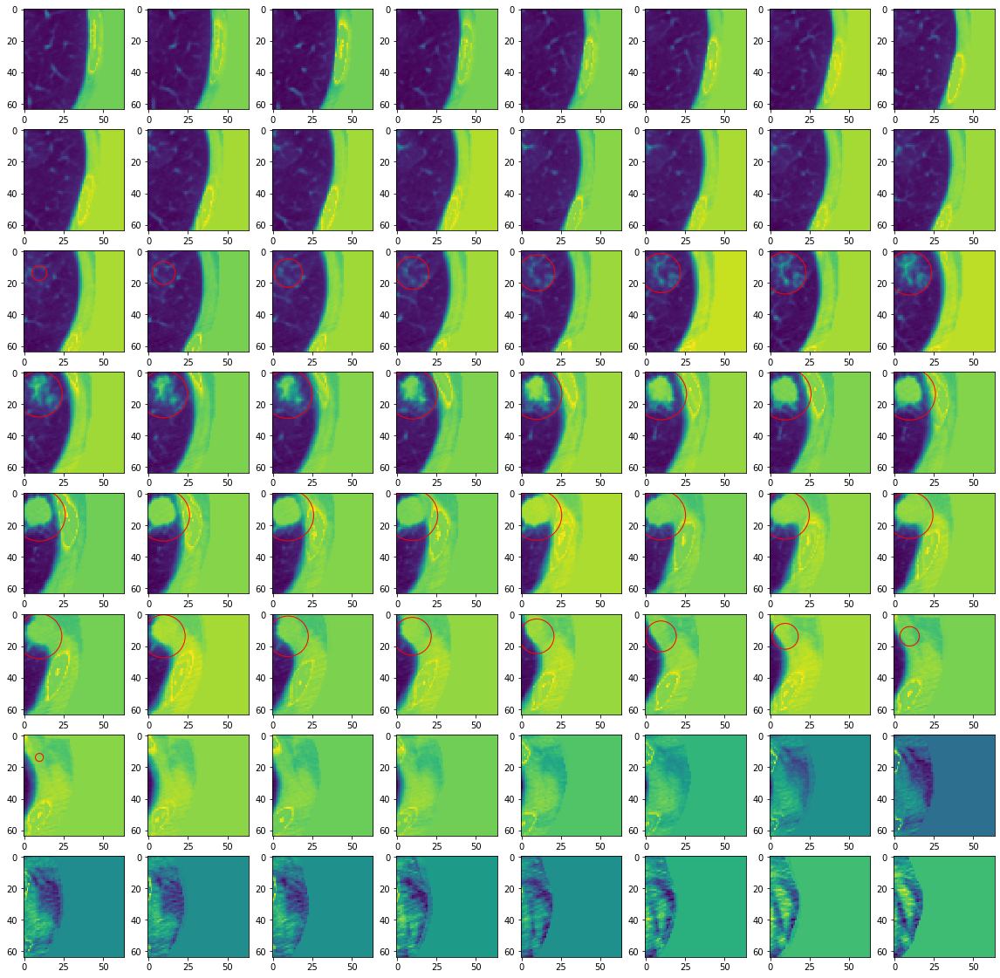

idx 23
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.08789015 33.092094   13.256283    8.831436   17.719482  ]]


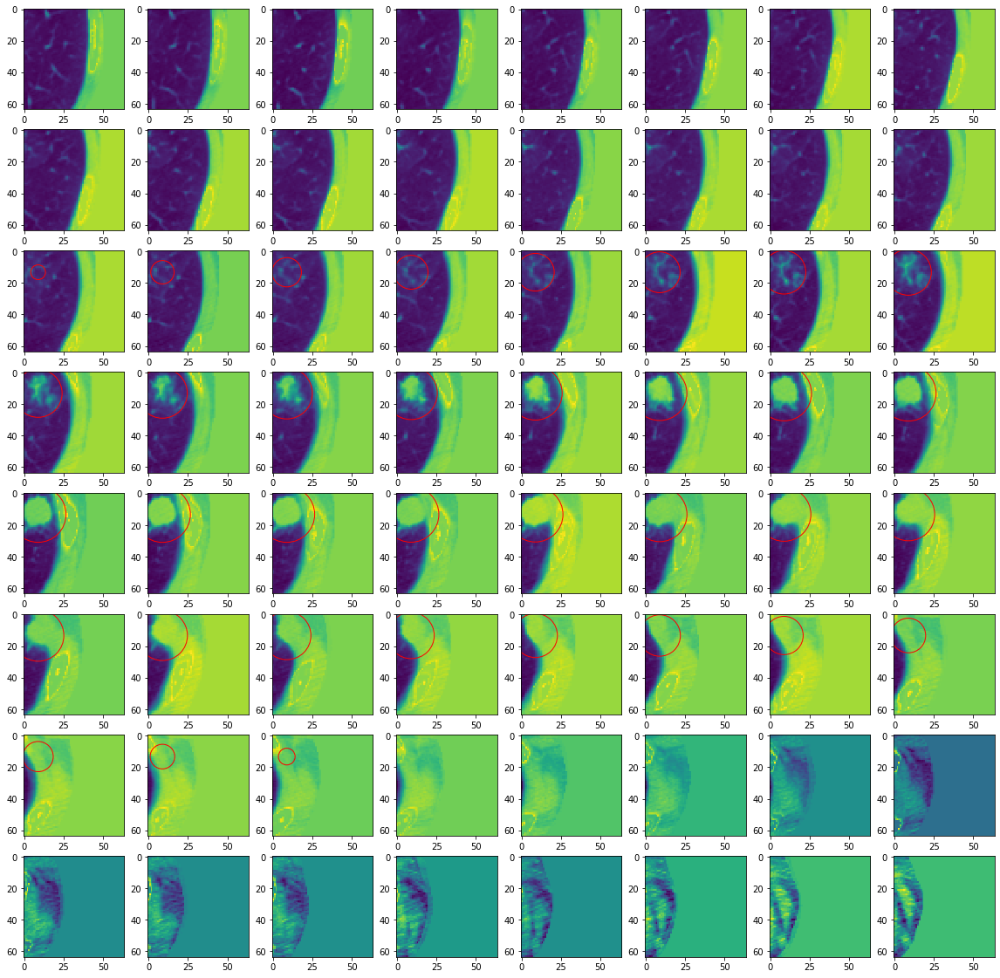

idx 24
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.37190437 29.370428   13.081482    9.450373   17.896055  ]]


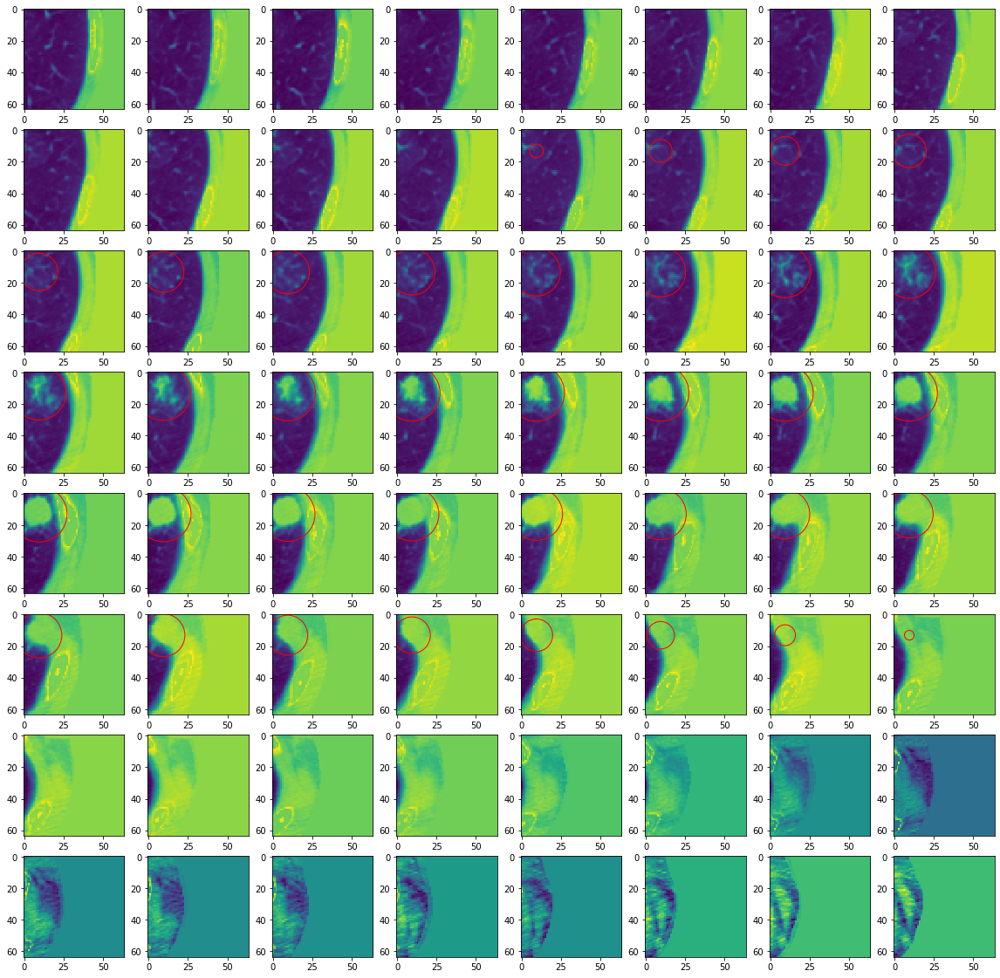

idx 25
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4983766  29.58292    13.64263     9.242307   17.267033  ]
 [-0.41308308 33.227516   13.637525    9.219113   11.788386  ]
 [-0.47683597 33.157192   13.523061    8.8996525  17.25044   ]]


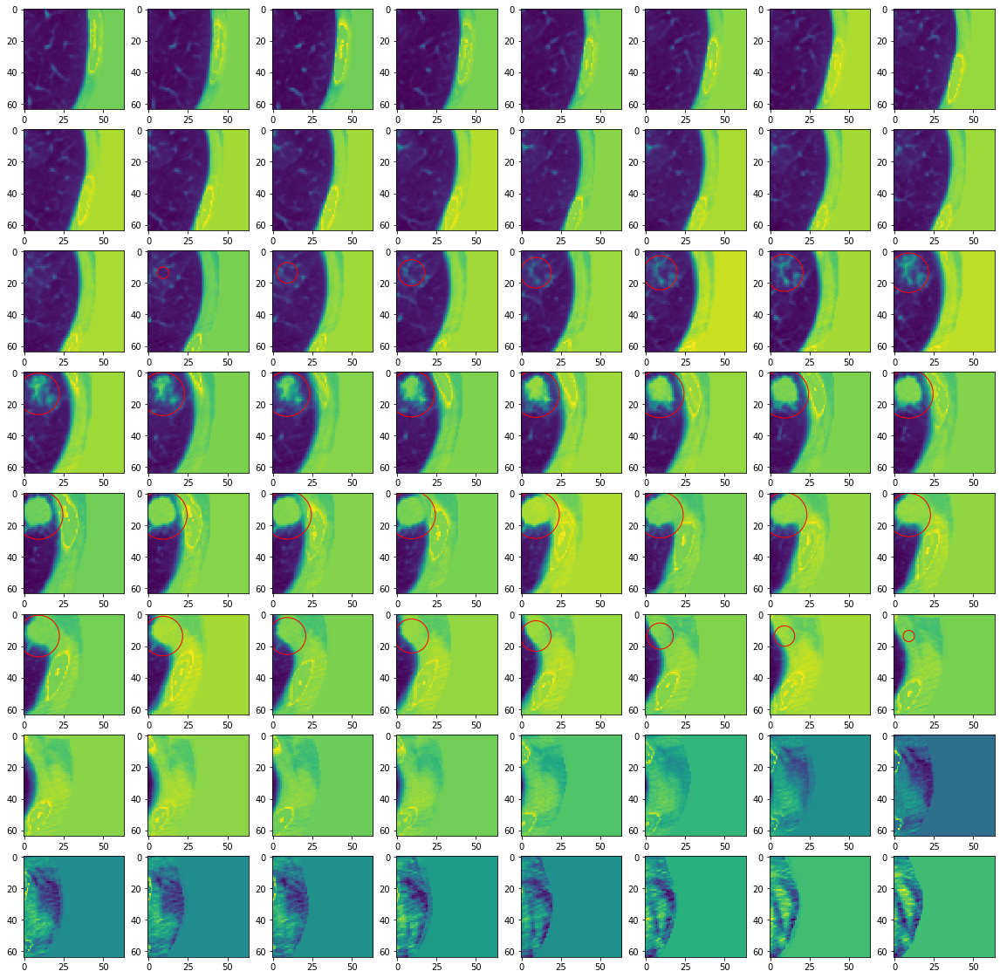

idx 26
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.24907684 33.27146    13.58174     9.15069    11.33554   ]
 [-0.28720284 33.05343    13.433878    8.654363   17.06533   ]]


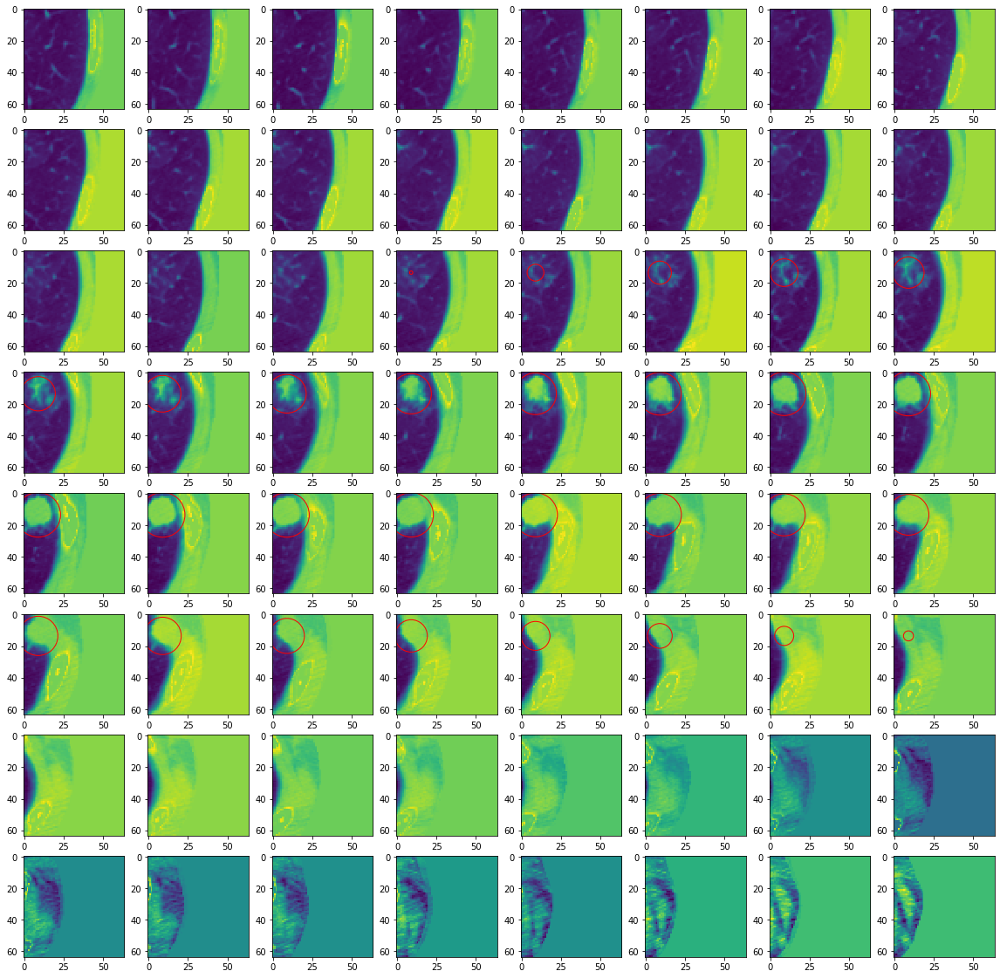

idx 27
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-4.2969632e-01  2.6136875e+01  9.3822260e+00  9.7802477e+00
   1.0554791e+01]
 [-1.3692999e-01  2.9603685e+01  1.3154883e+01  8.8865013e+00
   1.7591009e+01]
 [-3.6373138e-03  3.2985954e+01  1.3383511e+01  8.9072552e+00
   1.7970179e+01]]


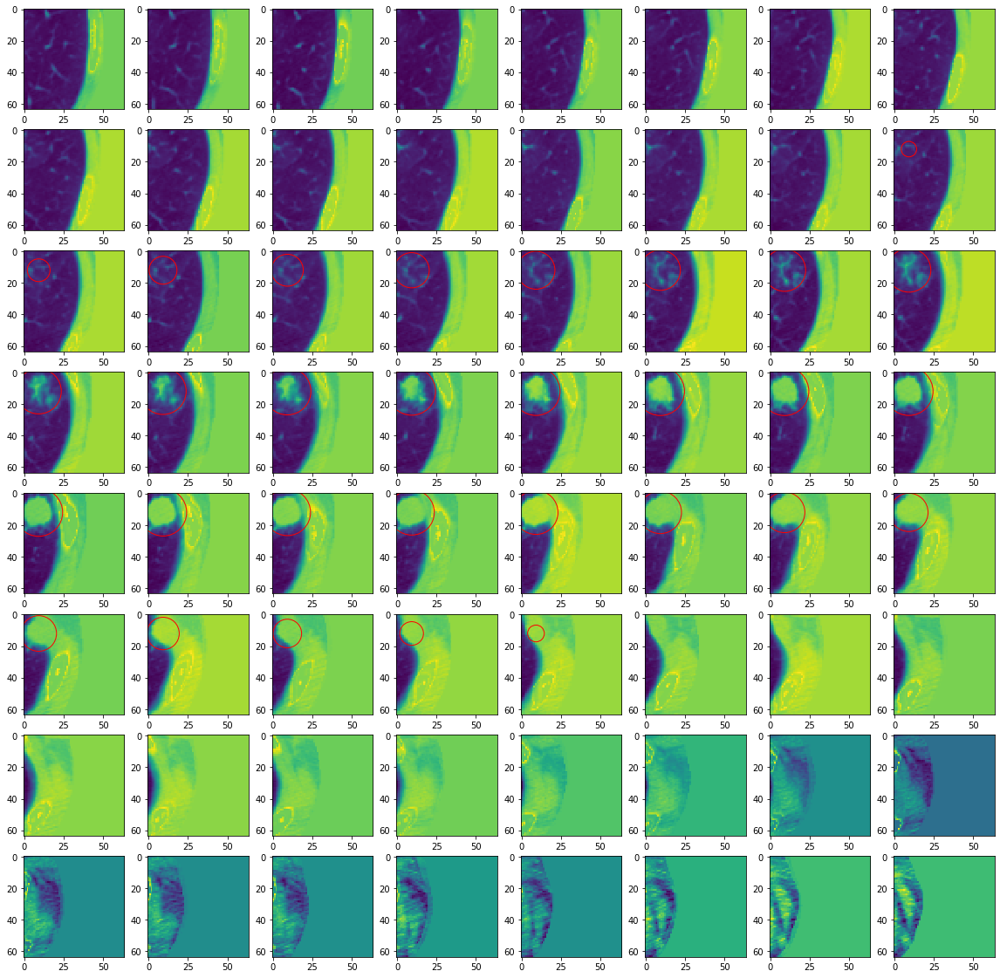

idx 28
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.07061672 29.24229     9.364208    9.296062   11.868647  ]
 [ 0.04115248 29.176025   13.0943165   9.055425   17.255562  ]
 [-0.04551172 32.452328   13.984459    9.676481   12.8490925 ]
 [ 0.82021856 32.403214   12.8221245   8.676057   17.02033   ]]


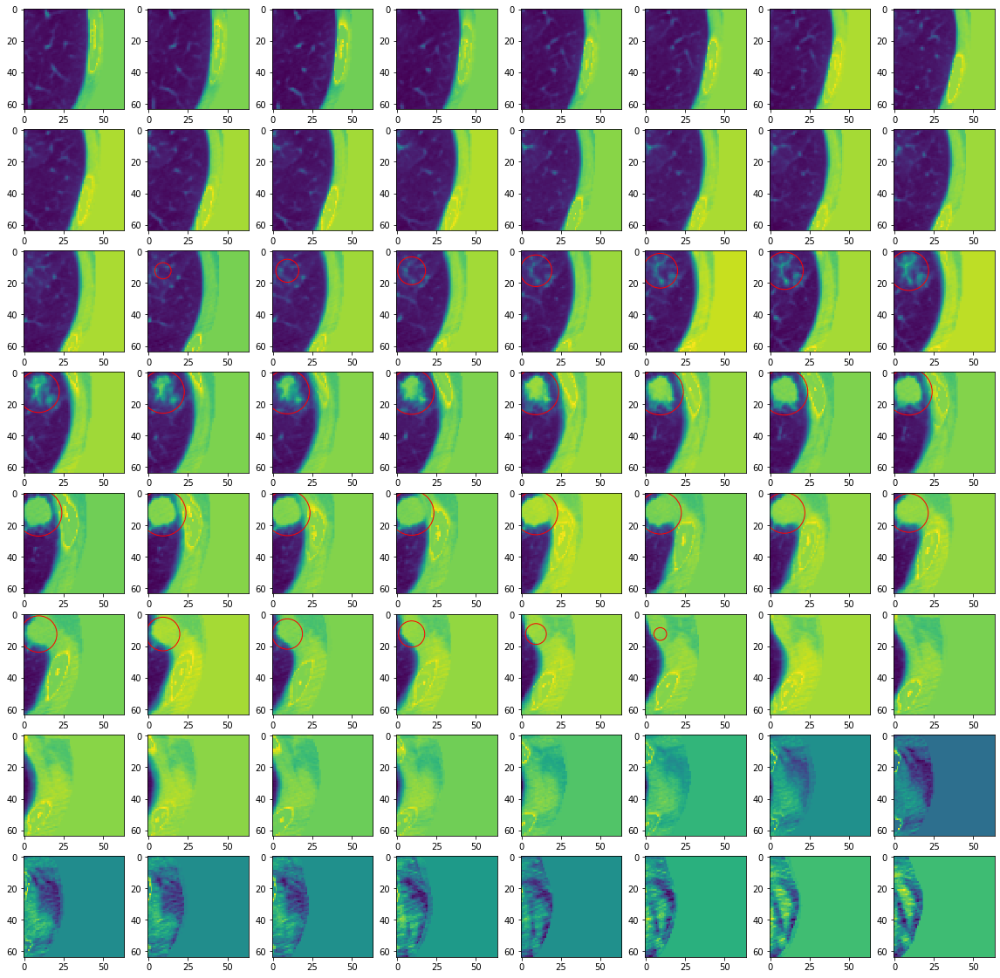

idx 29
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-4.96587753e-02  2.62859726e+01  9.34417534e+00  9.17715740e+00
   1.07524872e+01]
 [-3.90783310e-01  2.68735561e+01  9.28327465e+00  9.04156208e+00
   1.59019966e+01]
 [-7.29908943e-02  2.65726891e+01  9.13208961e+00  1.23325024e+01
   1.03465118e+01]
 [-4.92240667e-01  2.61805363e+01  1.35279408e+01  8.99310017e+00
   1.66514931e+01]
 [ 5.51741123e-01  2.91125412e+01  9.53006172e+00  9.09832478e+00
   1.19783802e+01]
 [ 2.71998882e-01  2.88145790e+01  9.56224346e+00  8.74037552e+00
   1.67164783e+01]
 [-4.55331802e-03  2.94713879e+01  1.35194778e+01  8.97431374e+00
   1.16077061e+01]
 [ 8.74614716e-03  2.93316879e+01  1.37113581e+01  8.79272461e+00
   1.65226822e+01]
 [ 2.44749069e-01  3.29261551e+01  1.34913721e+01  8.98684311e+00
   1.19335556e+01]
 [ 8.36411476e-01  3.25280228e+01  1.34488125e+01  8.50086212e+00
   1.66599503e+01]]


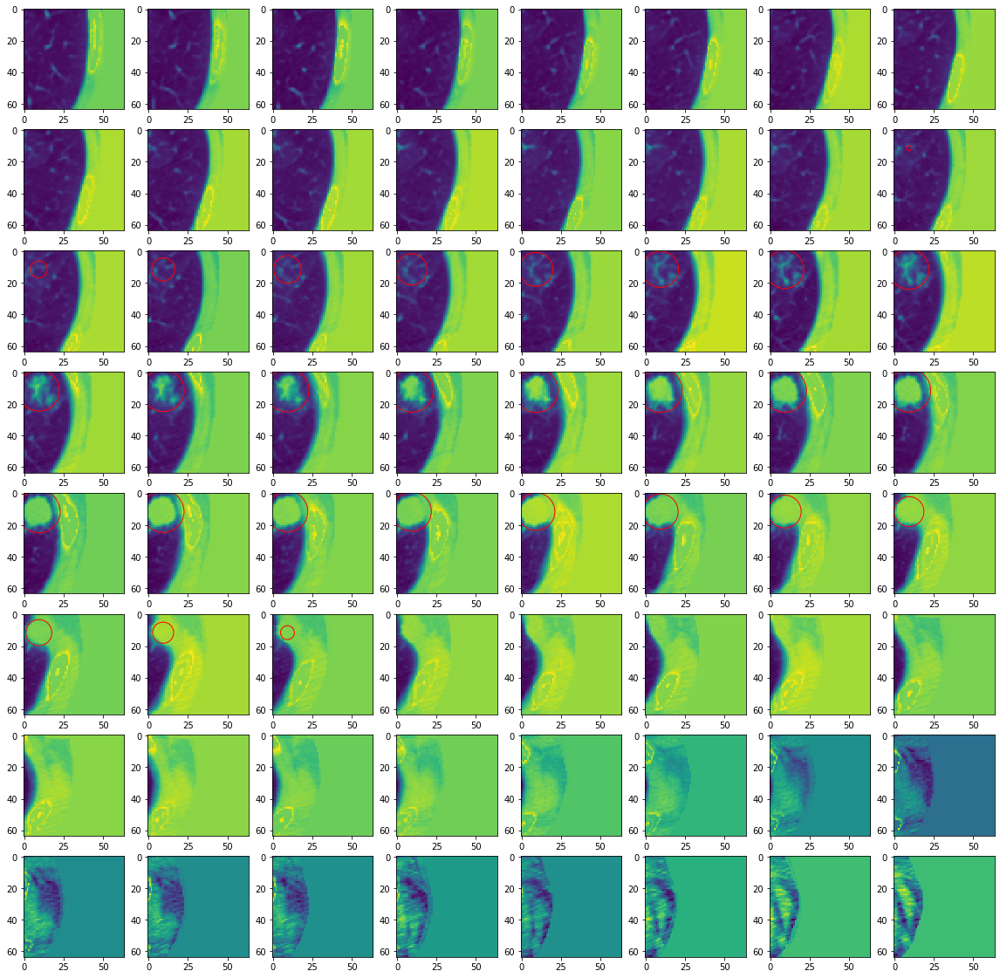

idx 30
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


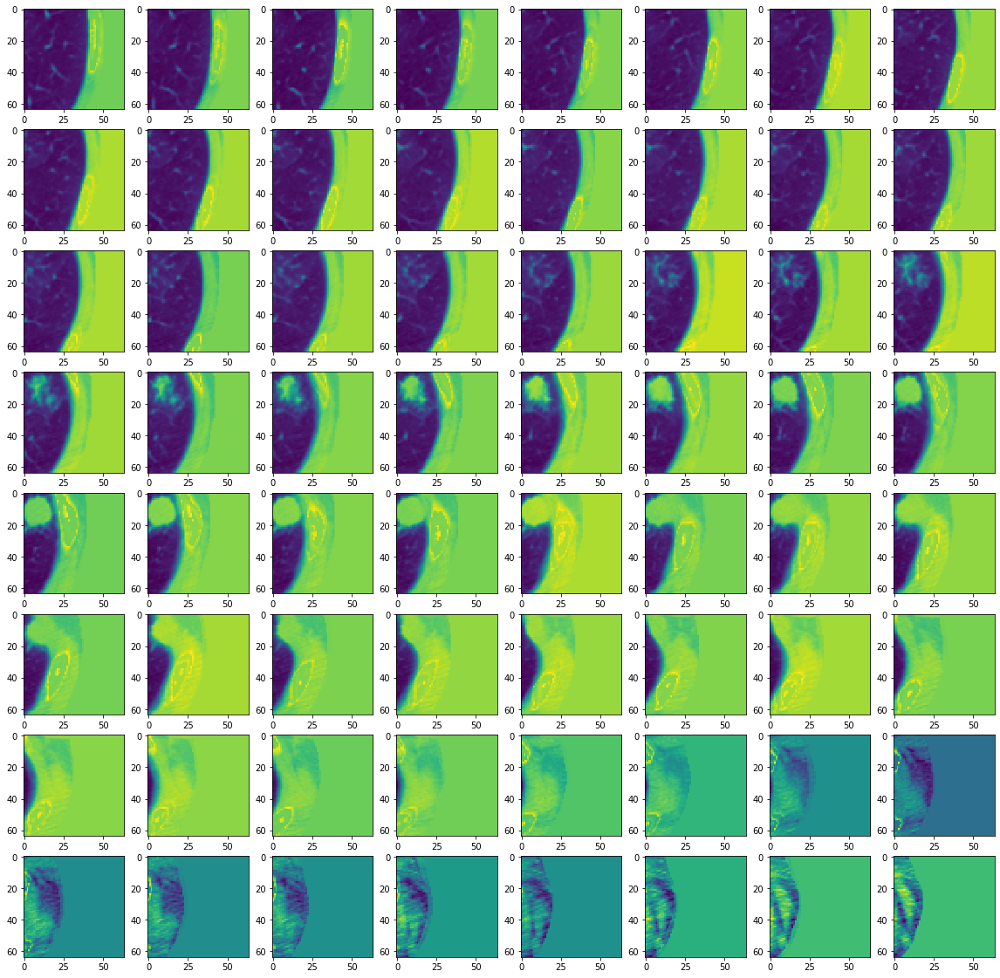

idx 31
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


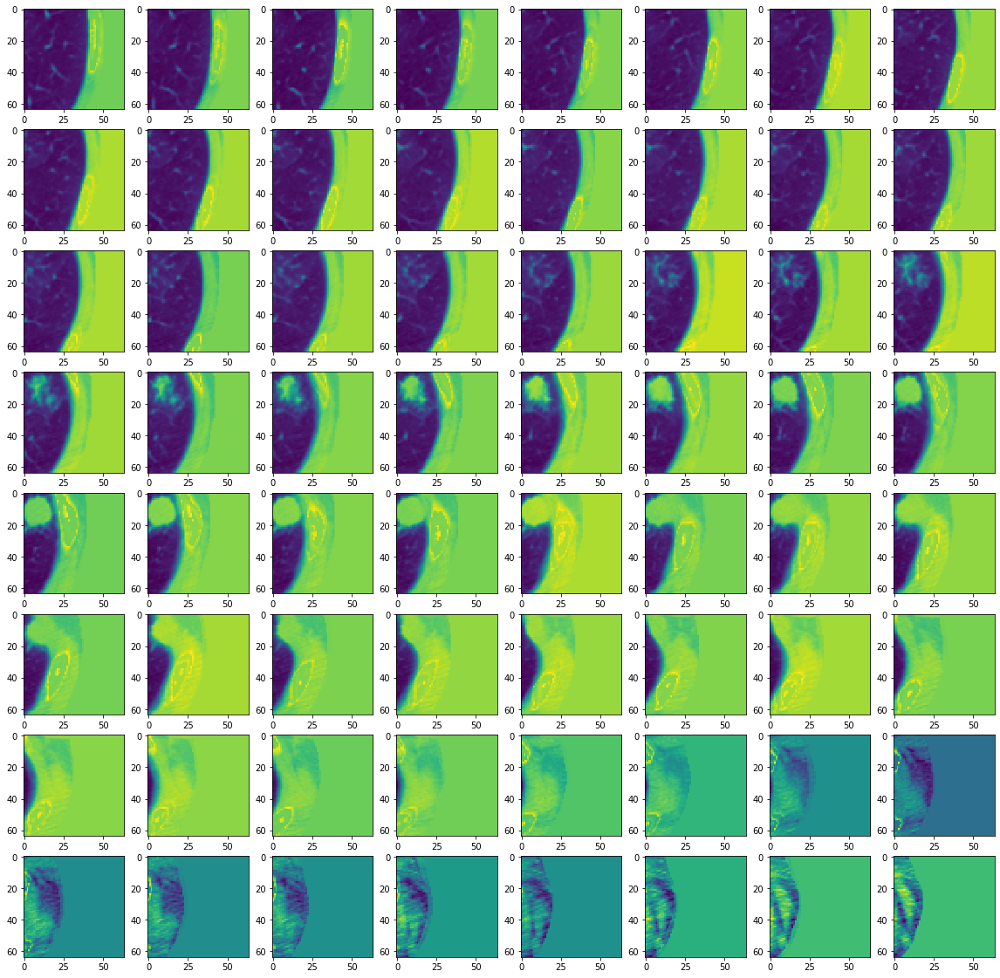

idx 32
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.440933   29.149988    9.727461    9.515679   11.028908  ]
 [-0.36453533 29.356003   13.7277      9.175233   17.204536  ]
 [-0.16988945 33.1516     13.618813    8.8002615  17.875889  ]]


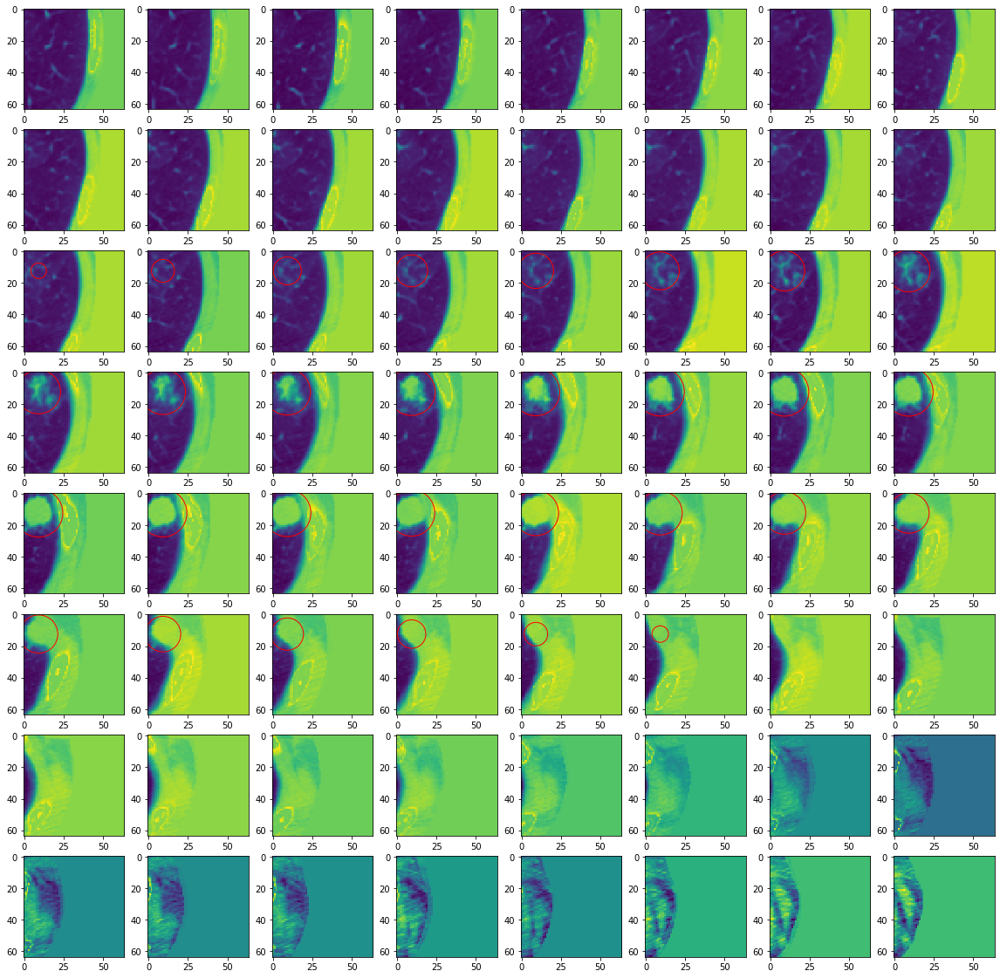

idx 33
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4271326  29.191267    9.629617    9.575748   17.87611   ]
 [-0.49378085 29.382988   13.683487    9.384095   11.235975  ]
 [ 0.3367424  29.175045   13.533057    8.908643   17.61341   ]
 [ 0.10966444 32.913      13.492794    8.771703   17.618698  ]]


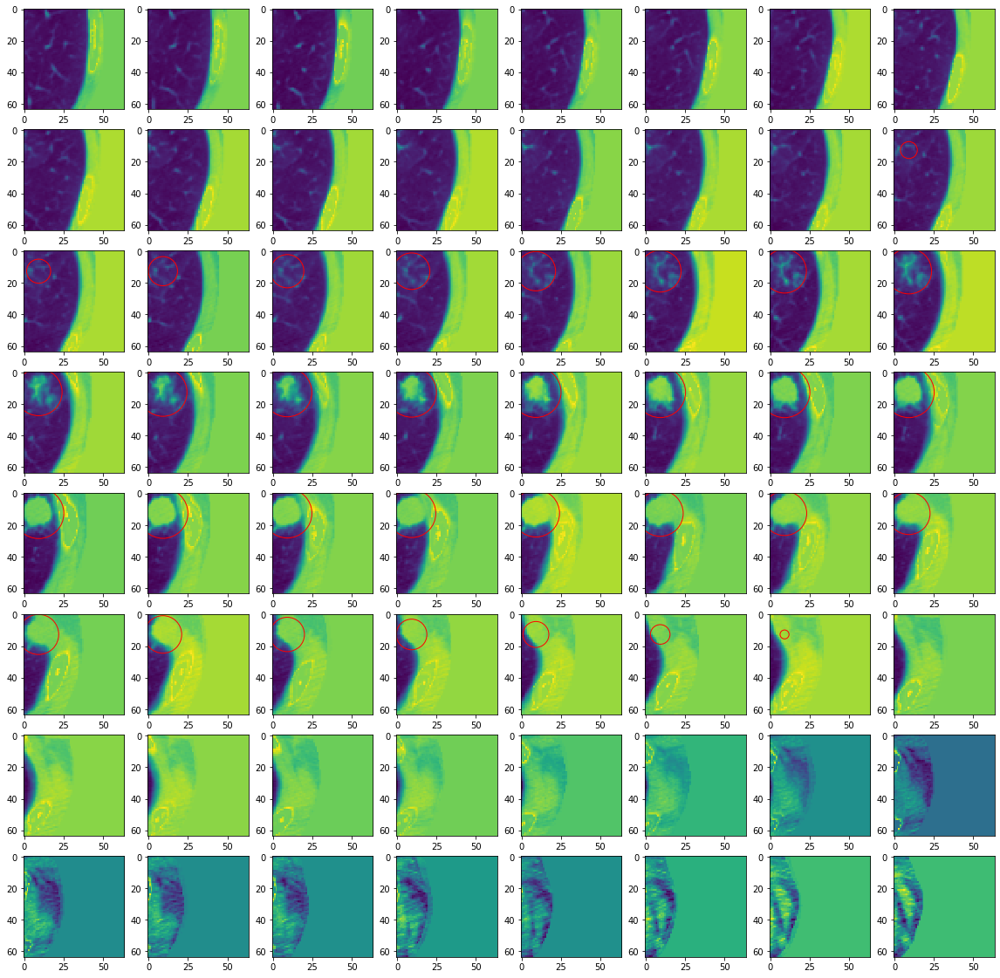

idx 34
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4997139 32.830456  12.987732   8.866442  17.197596 ]]


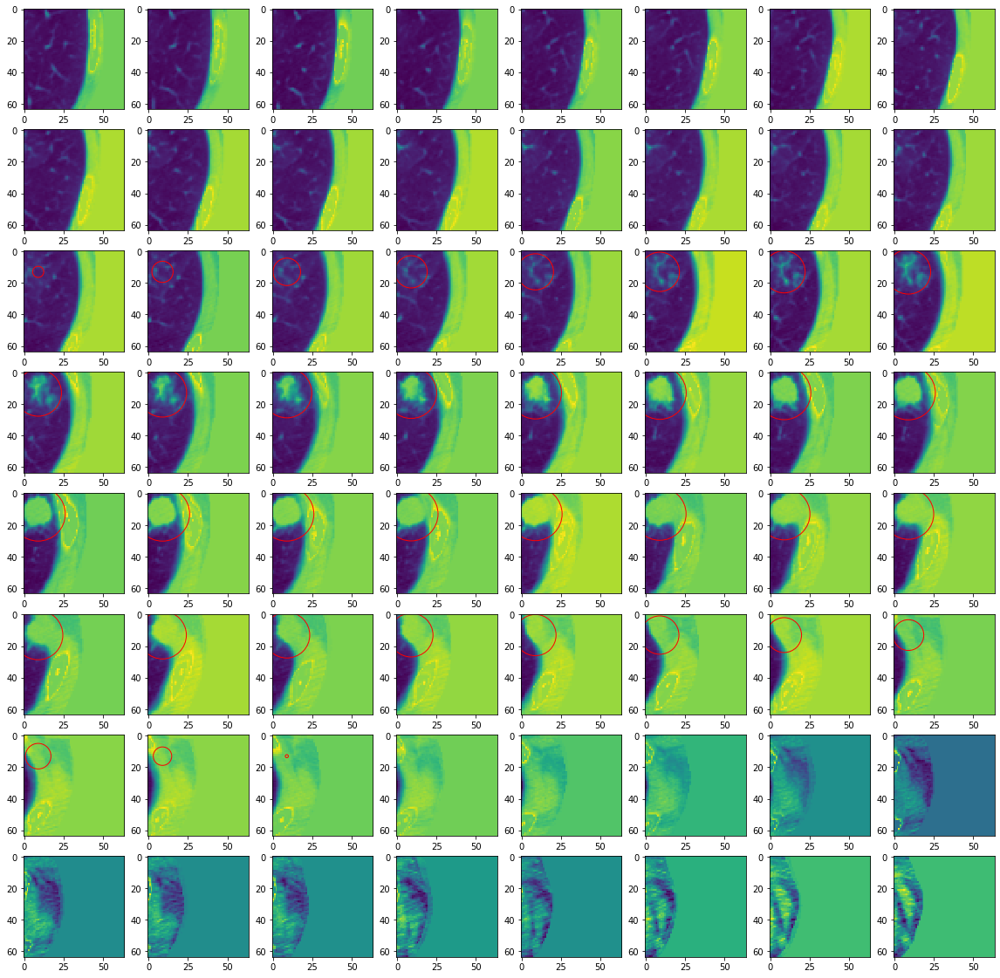

idx 35
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.46146607 29.275684   13.6518345   9.347727   11.563929  ]
 [ 0.06302834 29.031406   13.557862    8.916897   17.385117  ]
 [ 0.38215494 32.889908   13.516747    8.893494   19.385456  ]]


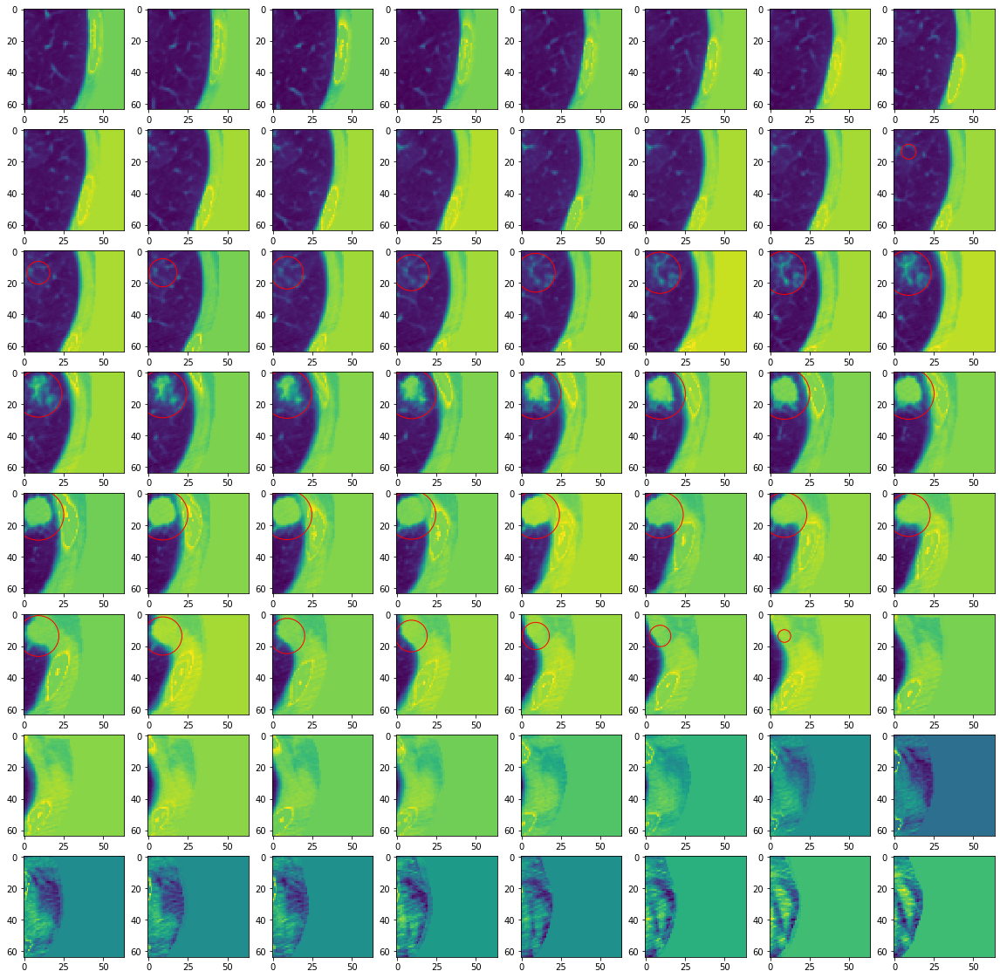

idx 36
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4807353  29.239      13.217056    9.0527935  17.974173  ]
 [ 0.10092497 32.71162    12.617475    8.787874   17.689932  ]]


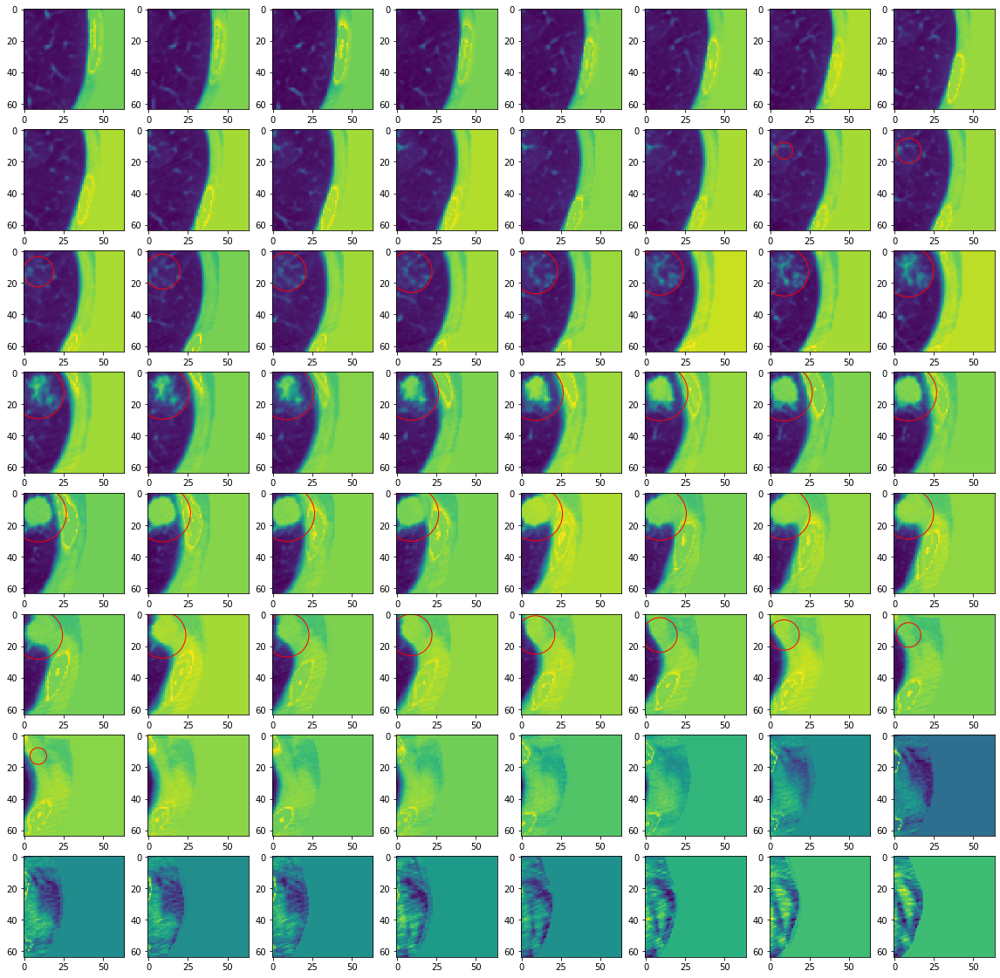

idx 37
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.19331169 29.270819   13.408913    9.247486   16.857523  ]
 [-0.3713858  32.97885    13.930552    9.646825   12.79628   ]
 [ 0.3152461  32.668903   13.421531    9.23632    17.312553  ]]


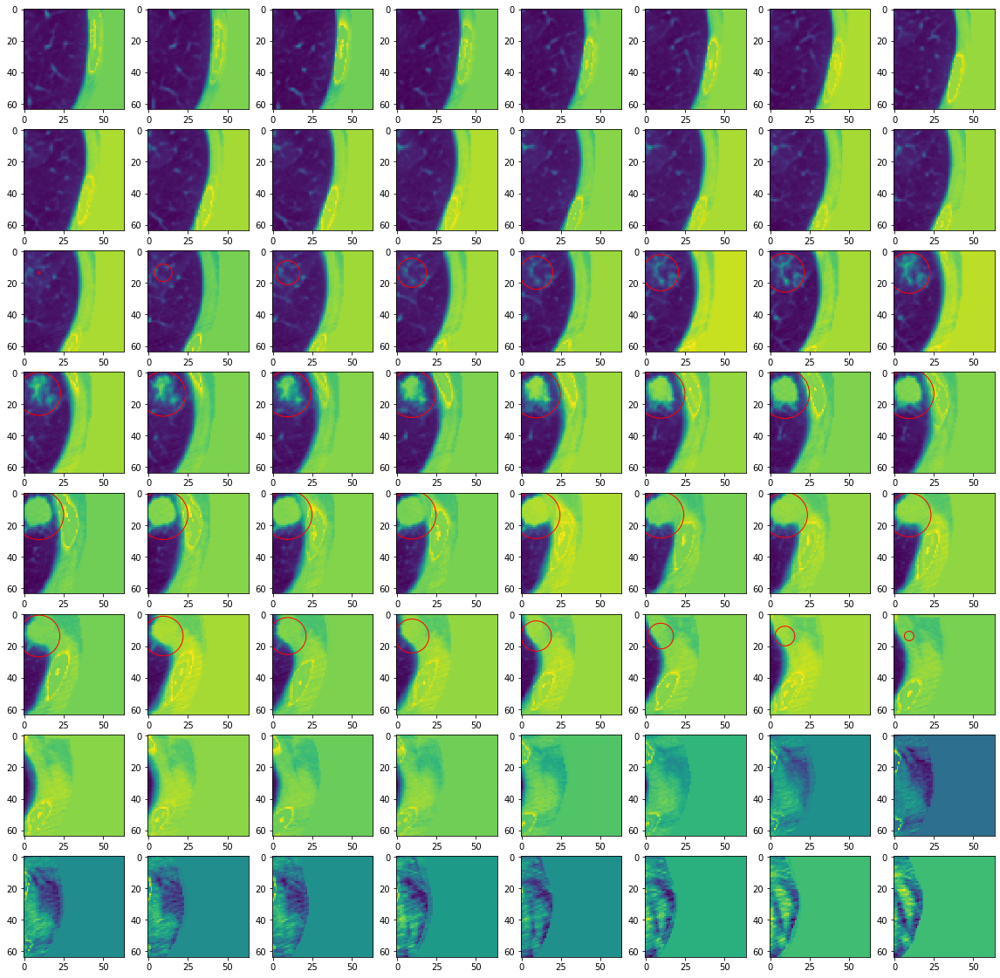

idx 38
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.09310532 26.037006    9.259185    9.750028   10.519142  ]
 [-0.1242938  26.127098    9.375875   13.413978   10.507626  ]
 [-0.23757505 25.806293   13.196935    9.632089   10.293348  ]
 [ 1.1430292  29.35327     9.253792    9.815115   11.8491125 ]
 [-0.15805674 29.597443    8.554574    9.180265   16.583424  ]
 [ 0.29217243 29.30403    13.390032    9.616641   11.759819  ]
 [-0.26481485 29.339743   12.884163    9.0052395  16.768314  ]
 [-0.3804505  29.79584    13.238727   13.0399275  10.899778  ]
 [ 0.7906847  33.156803   13.465644    9.32448    11.357917  ]
 [ 0.565681   32.975433   13.044209    8.625855   17.028336  ]]


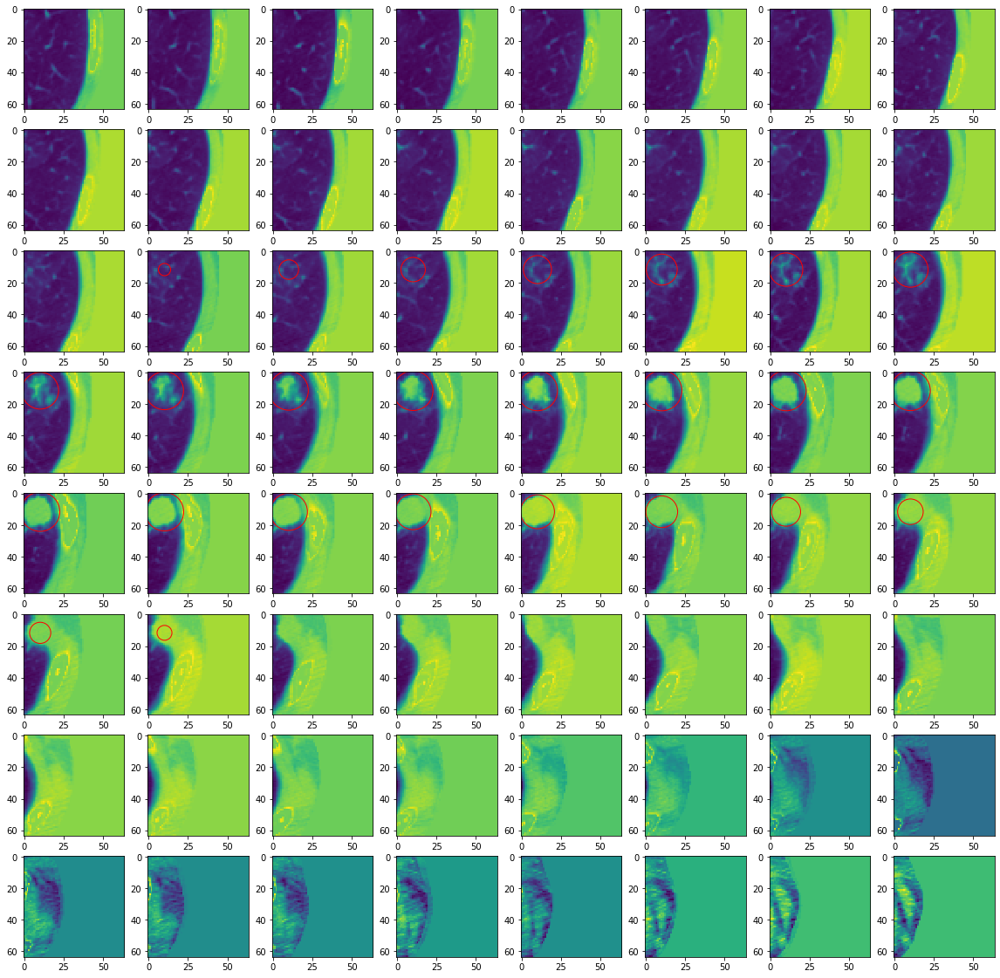

idx 39
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.35597944 29.596247   13.664068    9.282315   16.864464  ]
 [-0.2494855  32.6893     13.16867     9.145698   17.946789  ]]


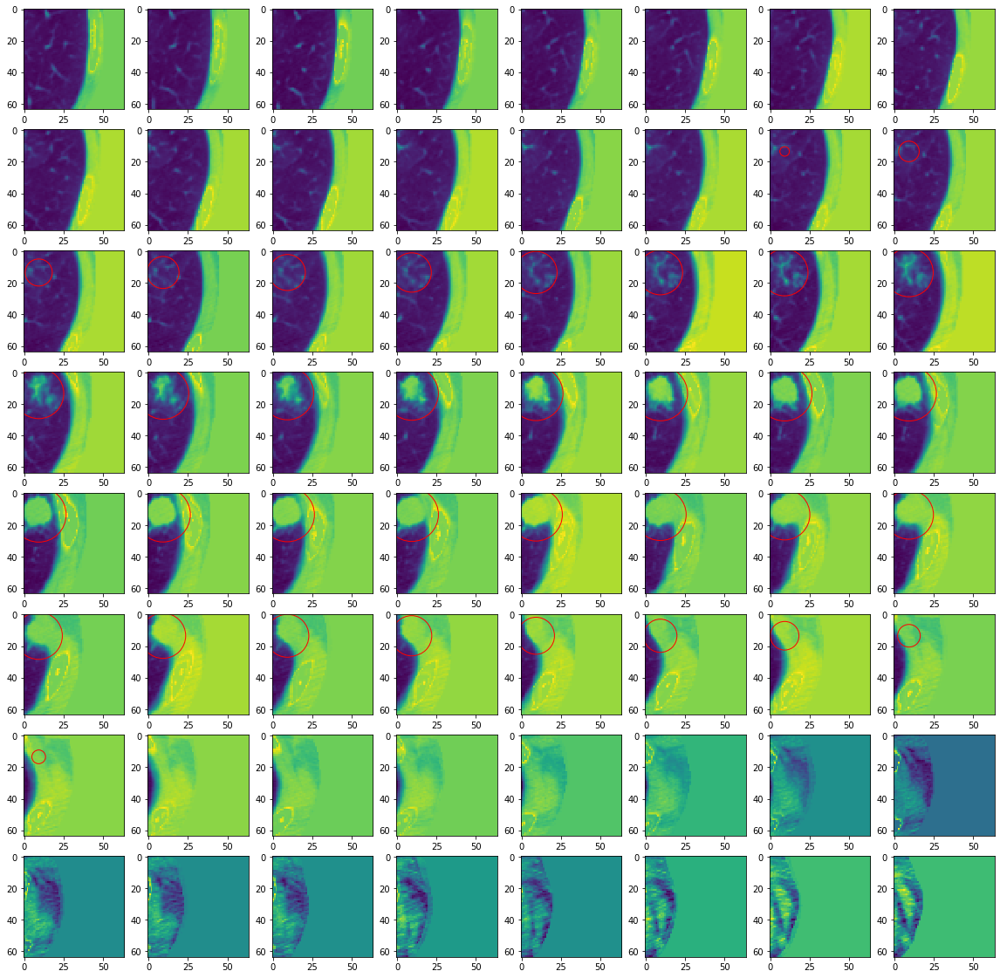

idx 40
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-4.68407869e-01  2.63201675e+01  9.87084103e+00  1.35015650e+01
   1.00730267e+01]
 [-1.02472305e-03  2.98943272e+01  1.35153131e+01  9.80962944e+00
   1.12681475e+01]
 [ 2.18335152e-01  3.01909924e+01  1.31450739e+01  9.43610859e+00
   1.71440620e+01]
 [-4.15995359e-01  3.30822411e+01  1.40262375e+01  9.67215347e+00
   1.16342249e+01]
 [ 3.50800514e-01  3.30006828e+01  1.33137093e+01  8.92104912e+00
   1.79441299e+01]]


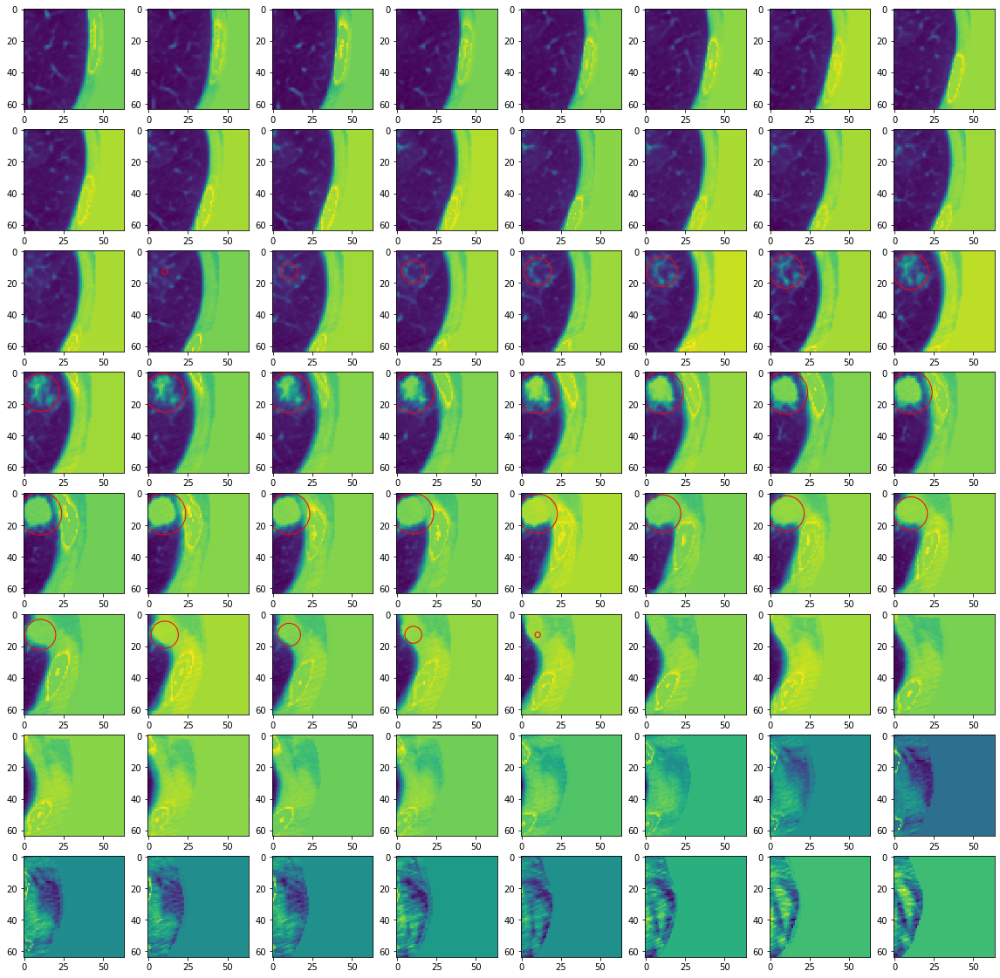

idx 41
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.32536077 33.04318    13.076453    8.6765585  17.18723   ]]


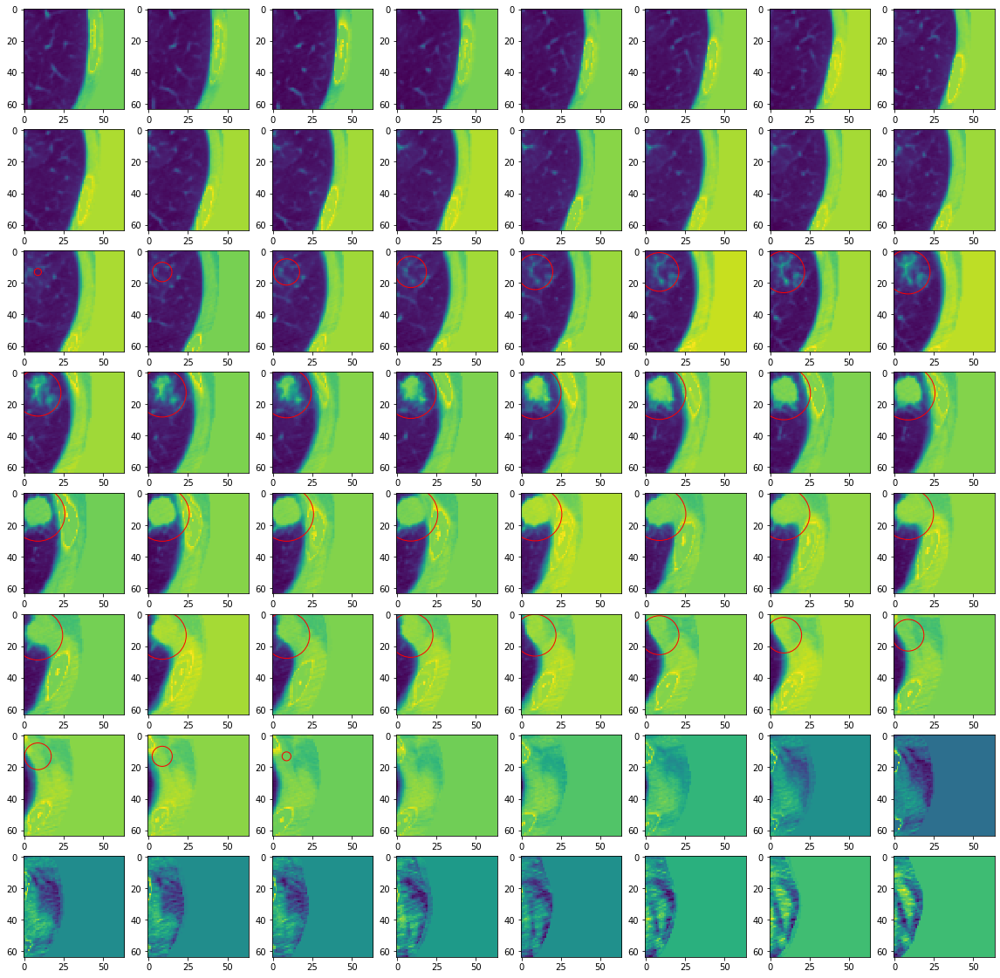

idx 42
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


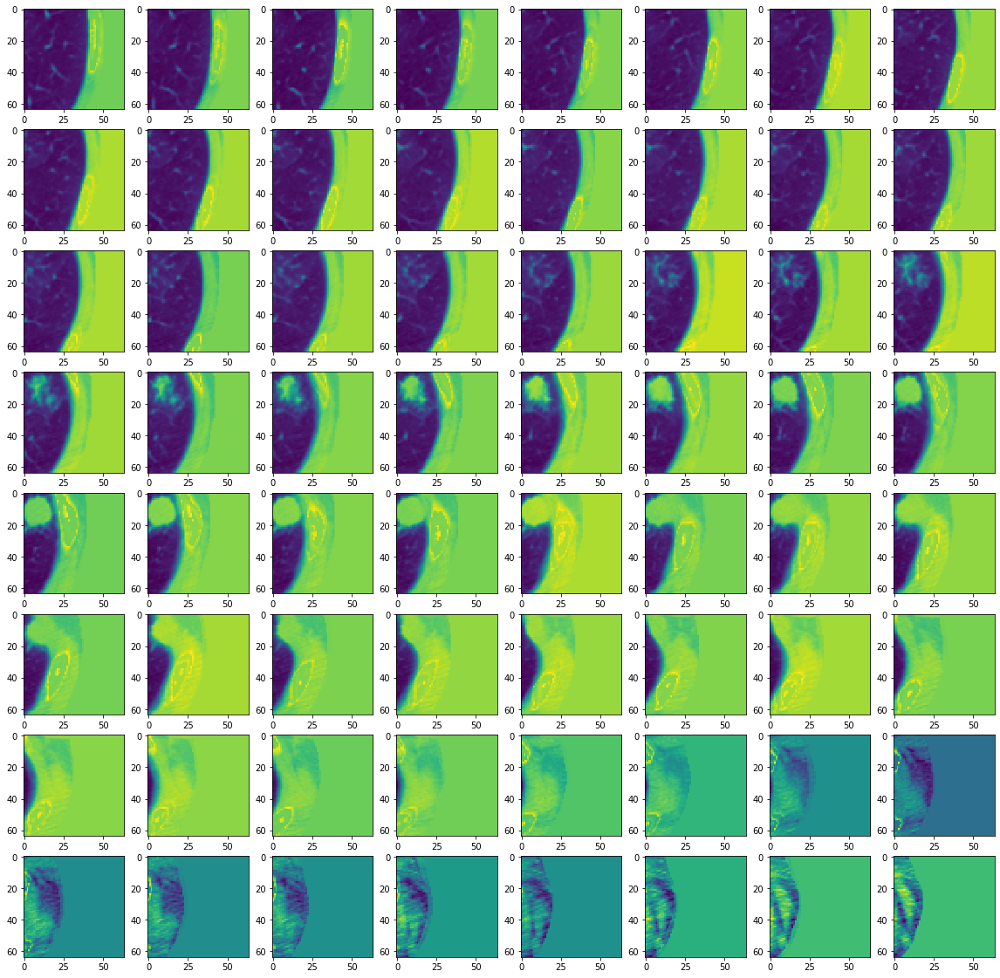

idx 43
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.06891441 25.92391     9.284162    9.602029   10.540365  ]
 [ 0.72144604 29.002474    9.268293    9.448145   11.813356  ]
 [-0.28731823 28.371468    8.200865    8.660731   15.880757  ]
 [ 0.2258439  29.38904    13.589702    9.665638   11.736017  ]
 [-0.22661972 29.78309    12.965483    9.233207   17.552765  ]
 [ 0.6615138  32.925014   13.818971    8.937314   12.10186   ]
 [ 0.40764284 33.356712   13.4212675   8.796557   18.005188  ]]


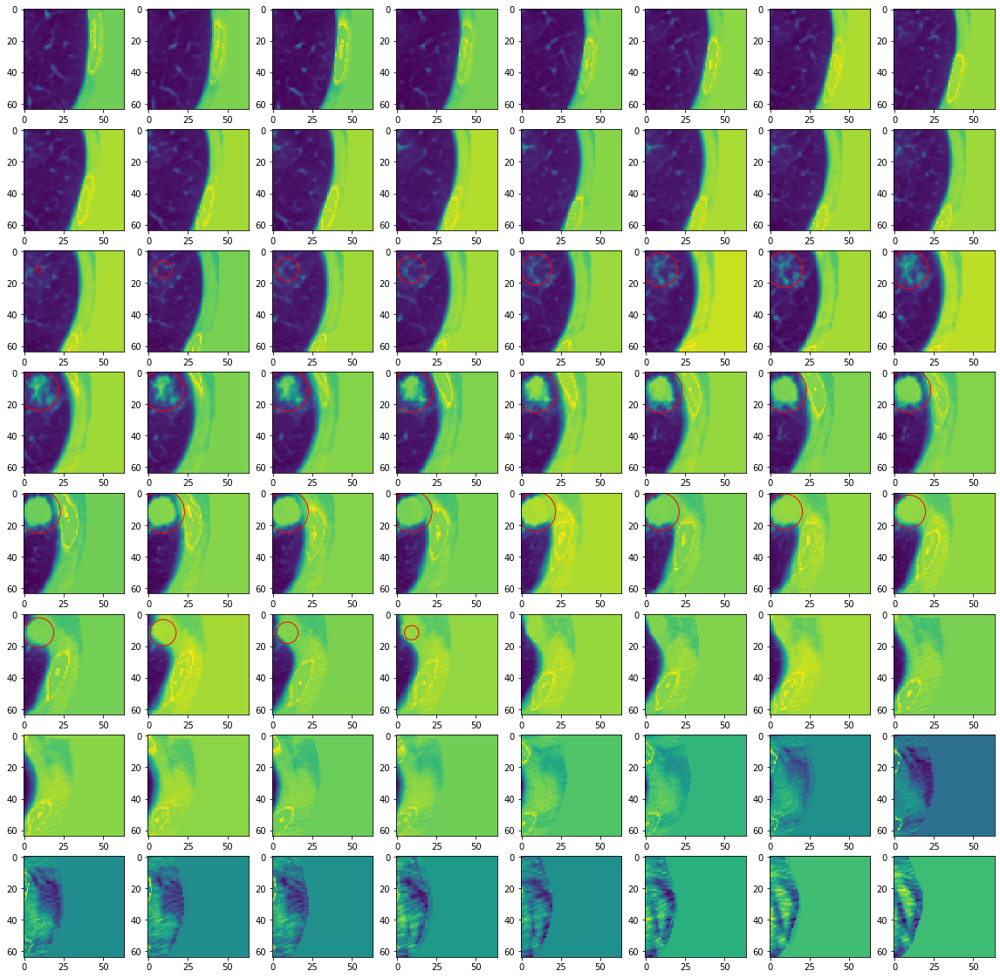

idx 44
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.20835066 29.381296    9.233751    9.874147   12.22817   ]
 [-0.41439104 29.40128    13.405436    9.762829   12.221297  ]
 [-0.1851244  29.524147   13.018453    9.337191   16.64496   ]]


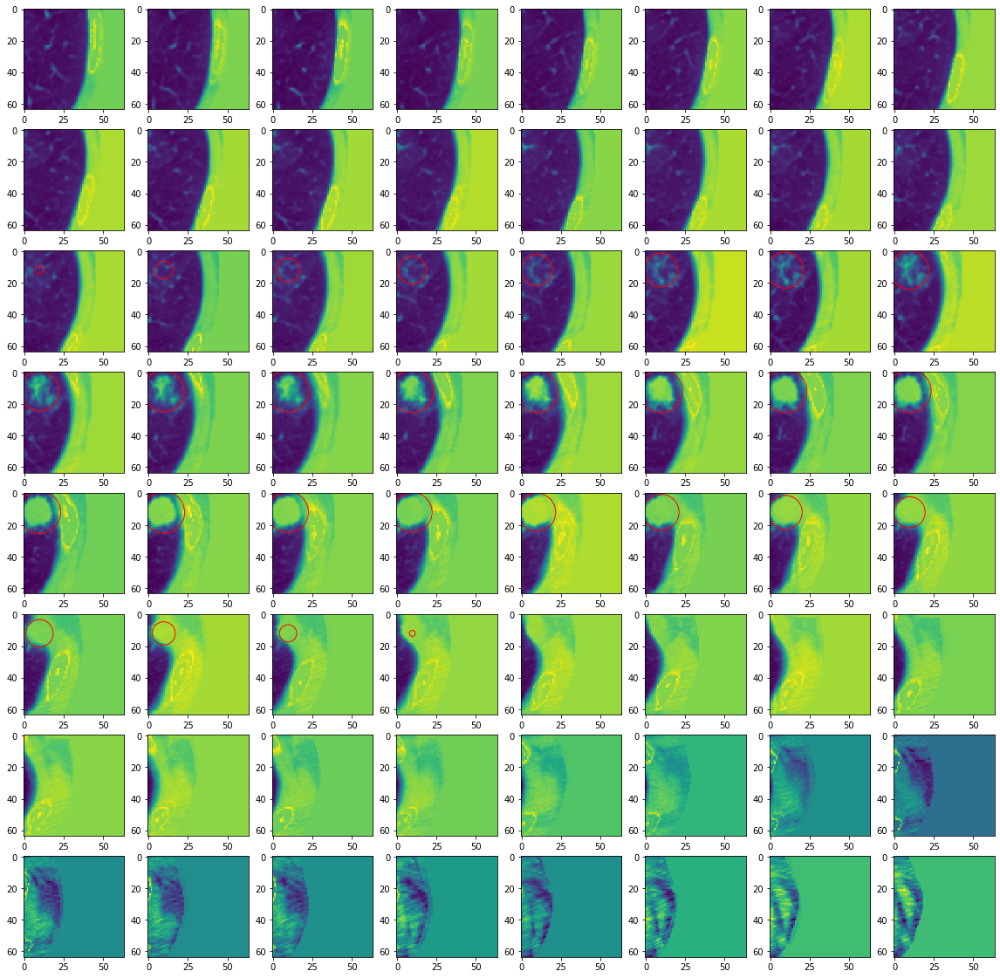

idx 45
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.04376173 26.080917    9.184606   10.025452   11.054338  ]
 [-0.4892454  26.521957   13.245697    9.479487   17.023418  ]
 [-0.04554272 29.478123    9.475471    9.830986   12.597132  ]
 [-0.2974453  29.627388   13.533562    9.638002   12.11735   ]
 [ 0.24075127 29.741993   13.478714    9.47416    16.78568   ]
 [-0.28371716 33.221706   13.497335    9.417828   12.02265   ]
 [ 0.46369457 33.089092   13.314948    8.99525    16.812967  ]]


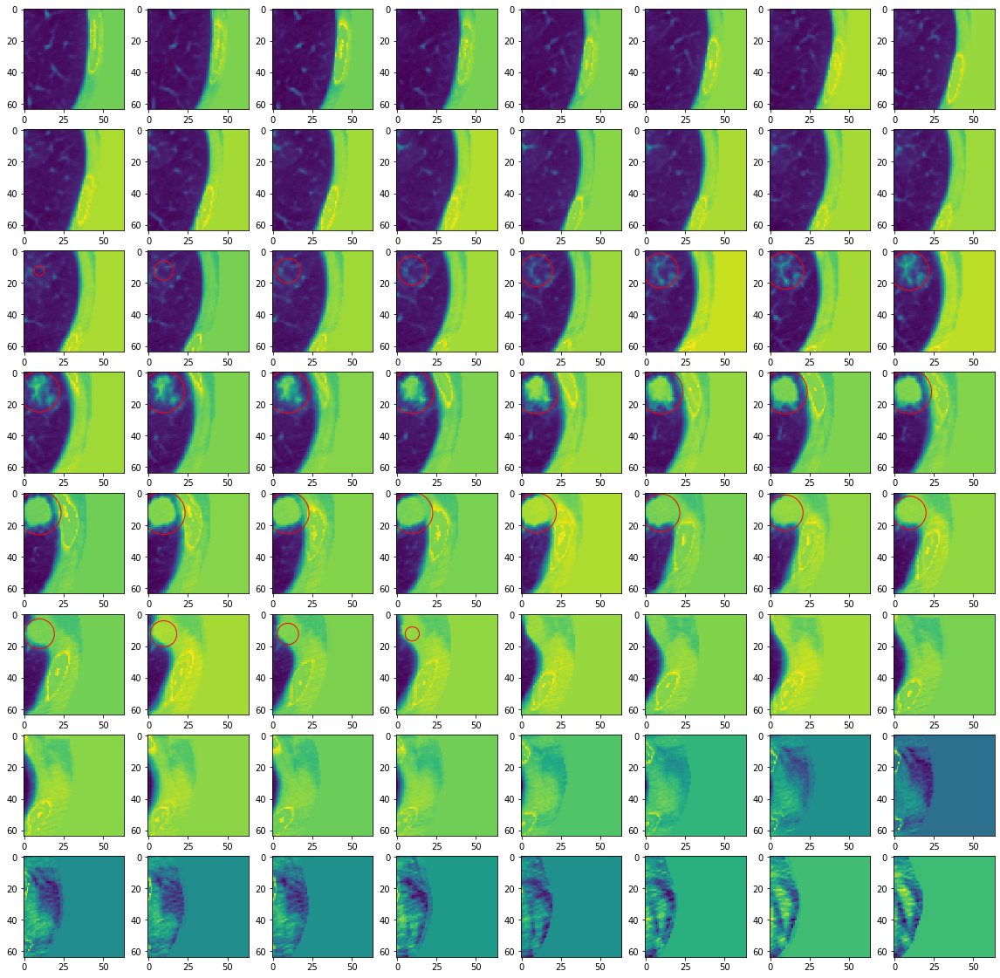

idx 46
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.4940369 33.595303  12.916072   9.2775    18.372816 ]]


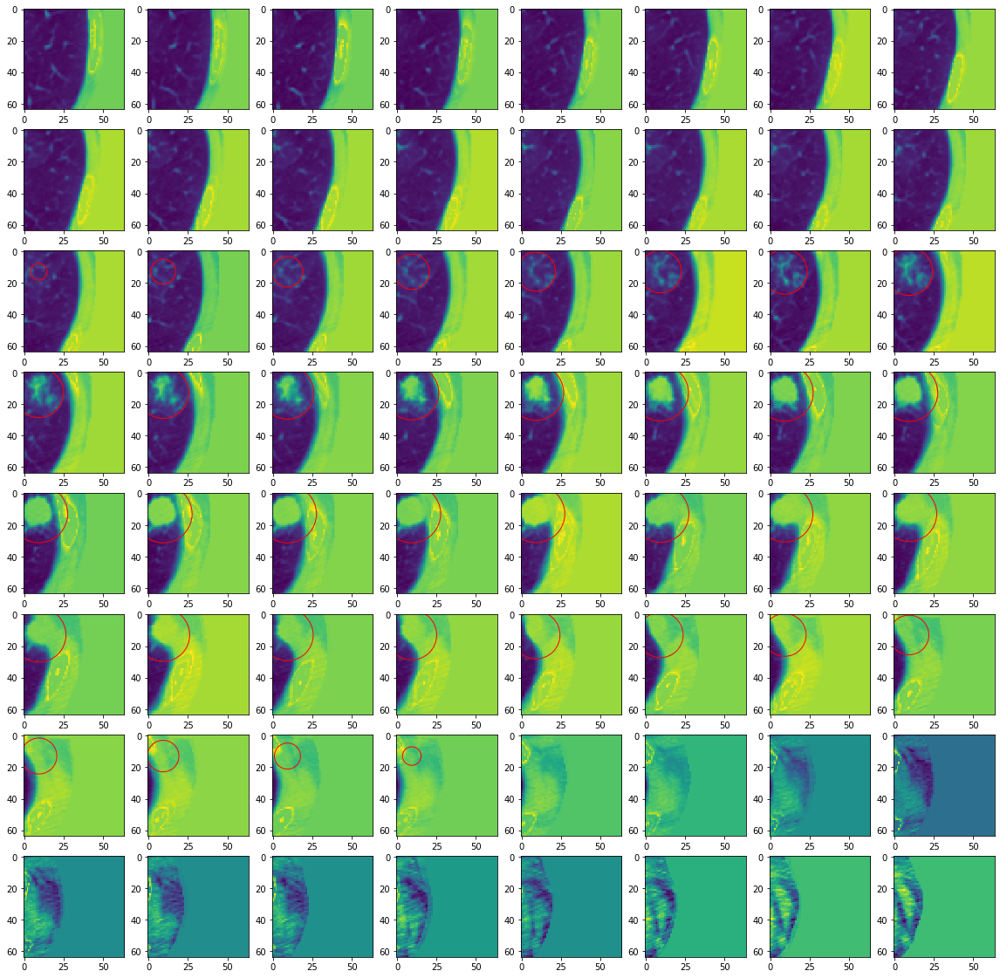

idx 47
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-3.4330893e-01  2.5738667e+01  5.9308481e+00  1.3209924e+01
   5.5123968e+00]
 [-4.6208644e-01  2.5880638e+01  8.6732798e+00  9.1937580e+00
   1.7730316e+01]
 [-3.6554480e-01  2.6104647e+01  1.2879105e+01  9.0607185e+00
   1.7327232e+01]
 [-1.4255714e-01  2.9481543e+01  9.5009508e+00  9.7924356e+00
   1.1942687e+01]
 [-2.4704933e-03  2.9579332e+01  9.1409254e+00  9.3683176e+00
   1.7020180e+01]
 [ 2.4909639e-01  2.9513840e+01  1.3571076e+01  9.3477859e+00
   1.2020365e+01]
 [ 7.1125460e-01  2.9451227e+01  1.3664946e+01  9.2005796e+00
   1.6768610e+01]
 [ 6.5870762e-02  3.3358315e+01  1.4216010e+01  9.5976982e+00
   1.2305837e+01]
 [ 7.6905203e-01  3.2932980e+01  1.3494272e+01  9.0488710e+00
   1.8223824e+01]]


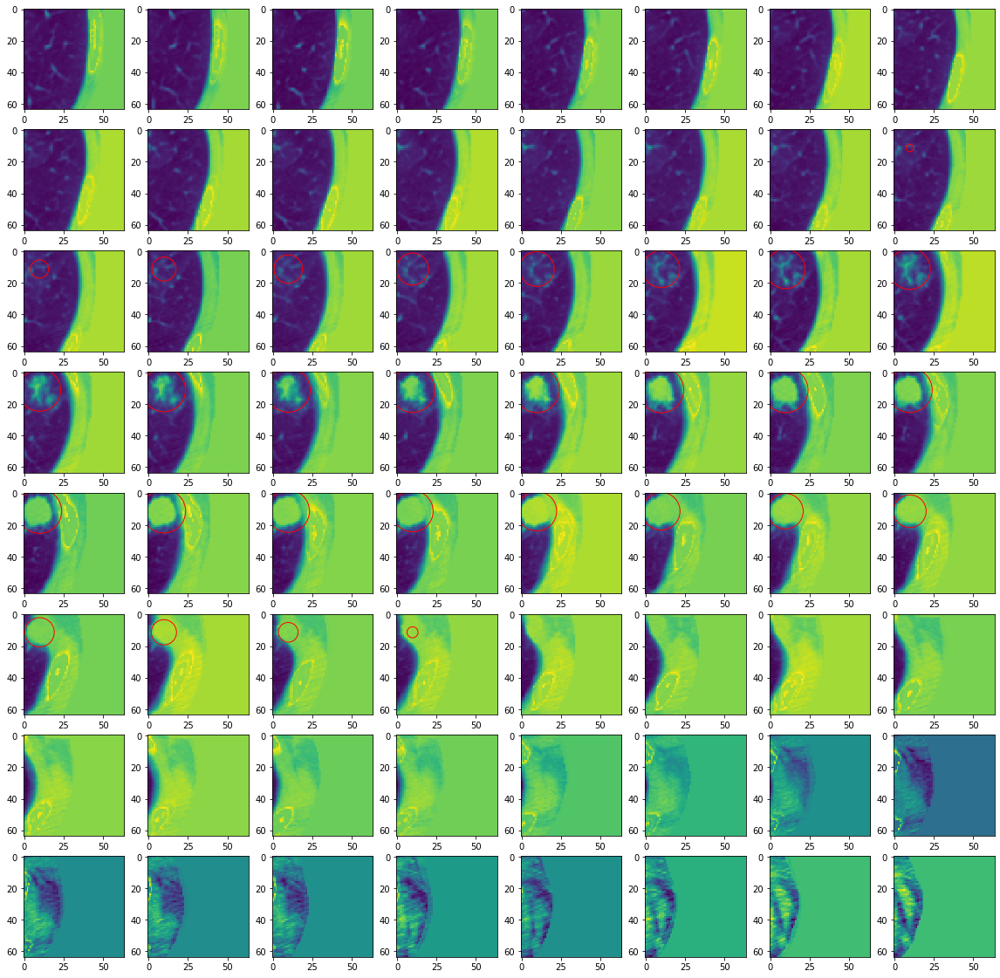

idx 48
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


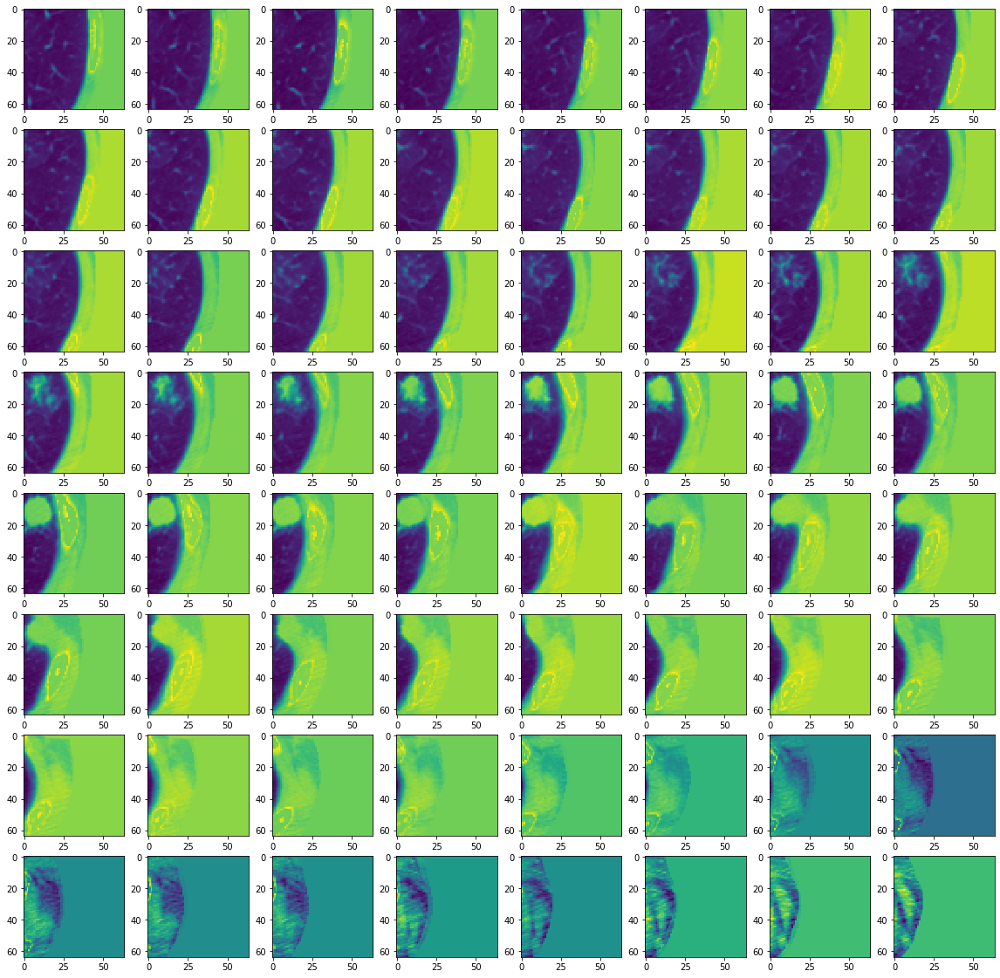

idx 49
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.45705605 29.247734   13.282655    9.495127   18.67986   ]
 [ 0.27685642 32.59723    13.2667      8.8914     18.788279  ]]


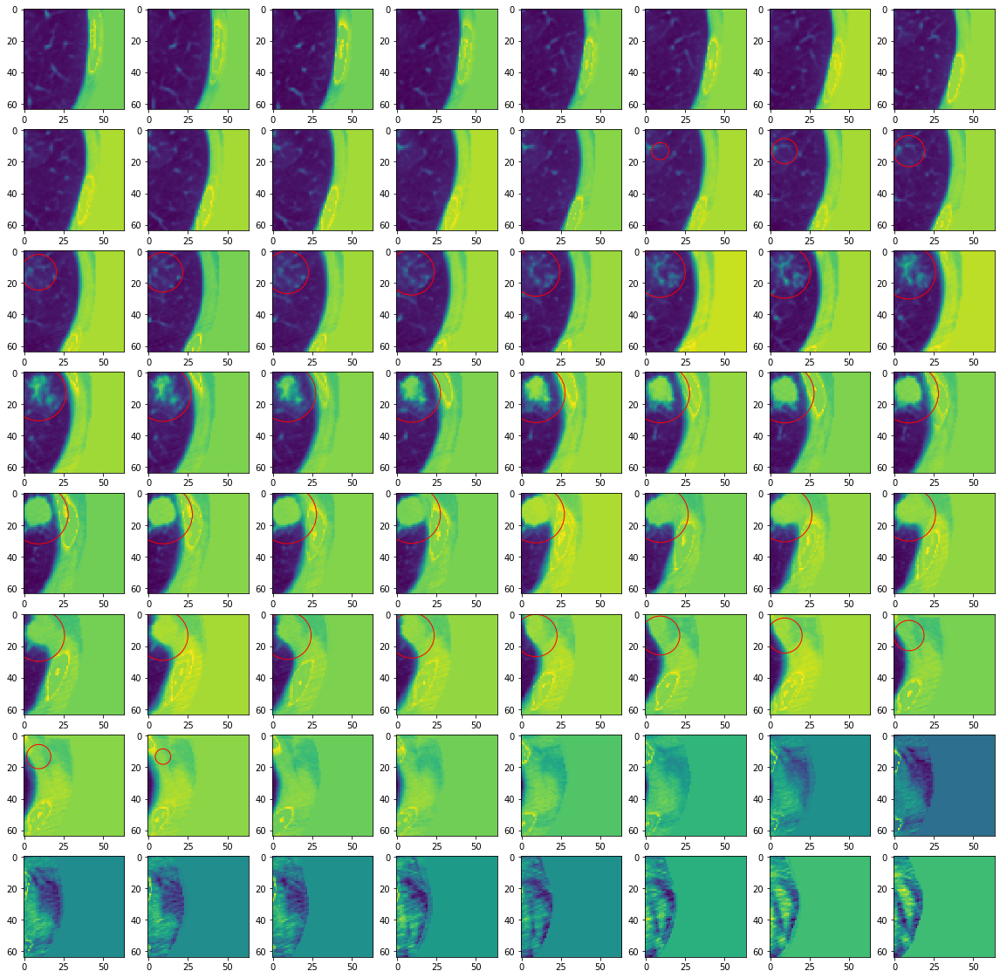

idx 50
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.27158022 29.333157    8.64329     8.818283   16.970522  ]
 [-0.23449373 29.690676   12.699085    9.195733   17.04425   ]
 [-0.4630127  33.214622   13.376715    9.476022   11.204391  ]
 [ 0.39959717 33.16493    12.711995    8.639842   16.957653  ]]


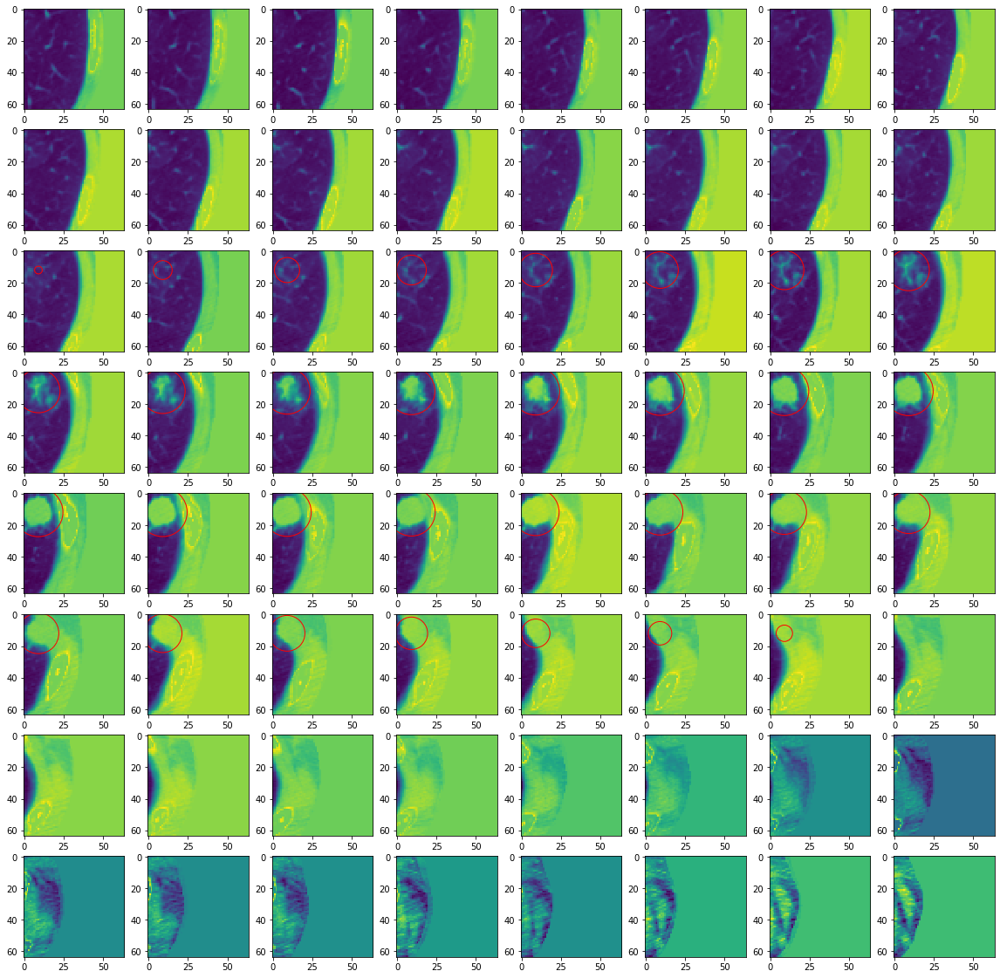

idx 51
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.22808218 26.184278    9.430713    9.592343   10.838548  ]]


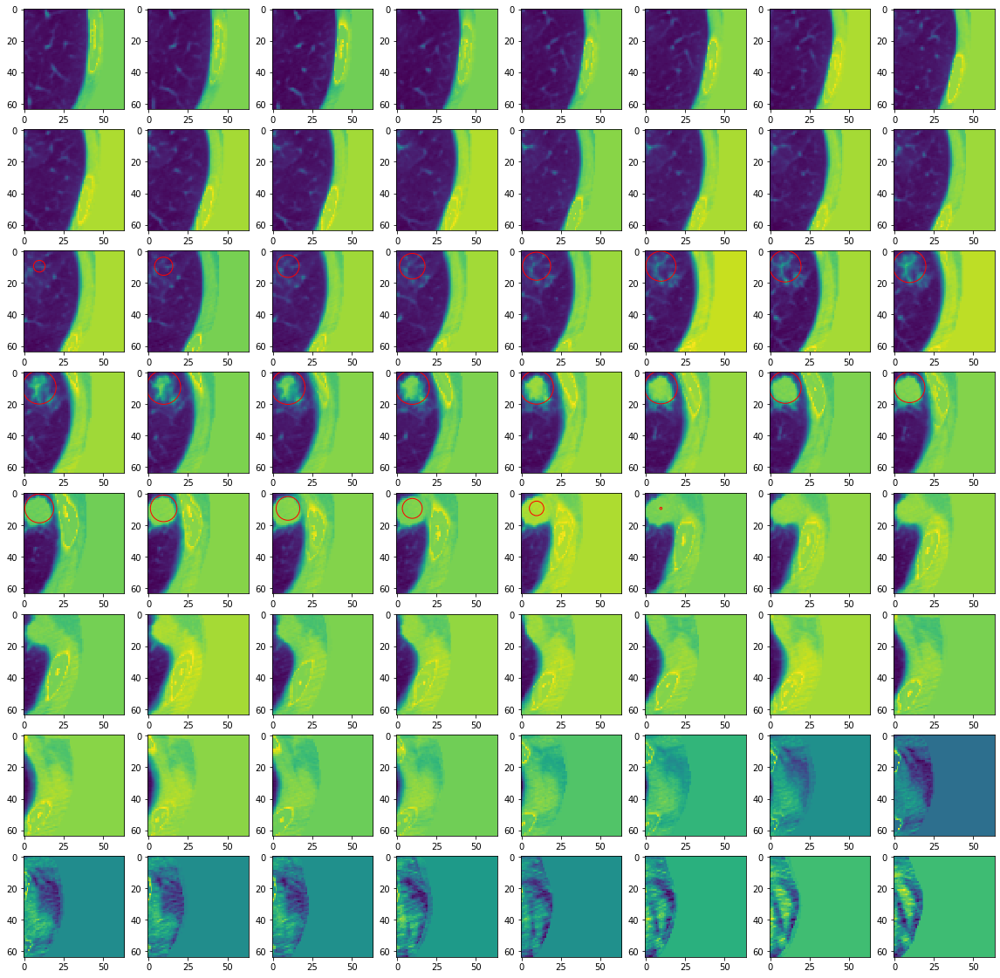

idx 52
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 2.1082163e-01  2.9471737e+01  8.9871531e+00  9.1996231e+00
   1.1163736e+01]
 [-4.2520308e-01  2.9961849e+01  8.6517134e+00  9.0477648e+00
   1.6196287e+01]
 [-3.1325054e-01  2.9720343e+01  1.2903095e+01  8.7843933e+00
   1.6664236e+01]
 [-2.1117210e-01  3.3400337e+01  1.3268704e+01  9.0775871e+00
   1.1198964e+01]
 [ 1.4701843e-02  3.3424648e+01  1.2912408e+01  8.4900913e+00
   1.6191040e+01]]


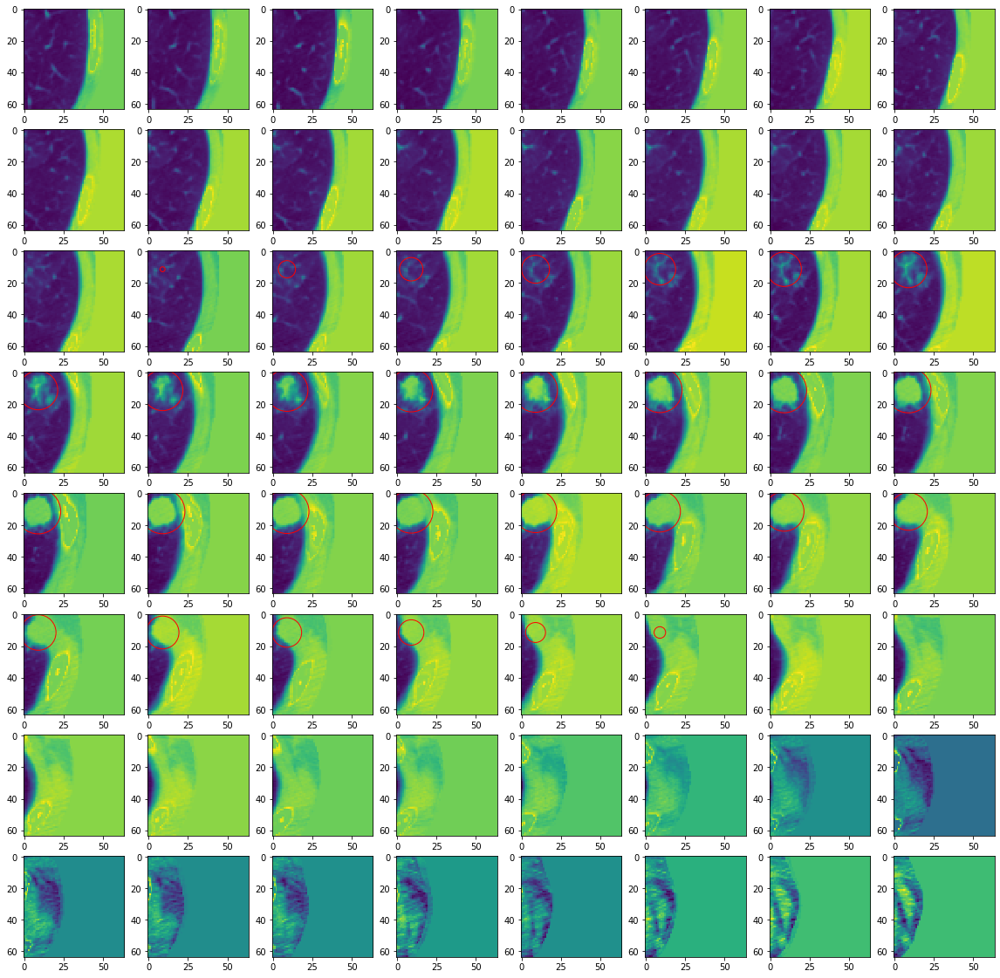

idx 53
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


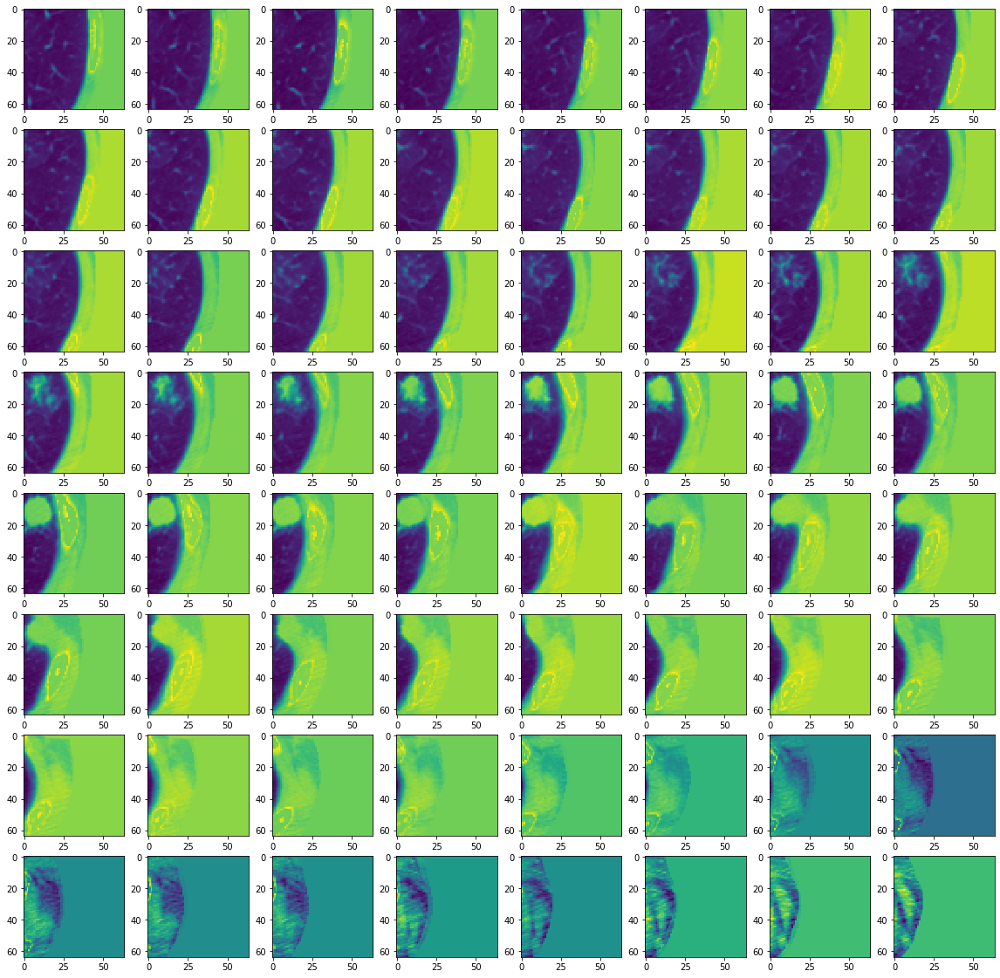

idx 54
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


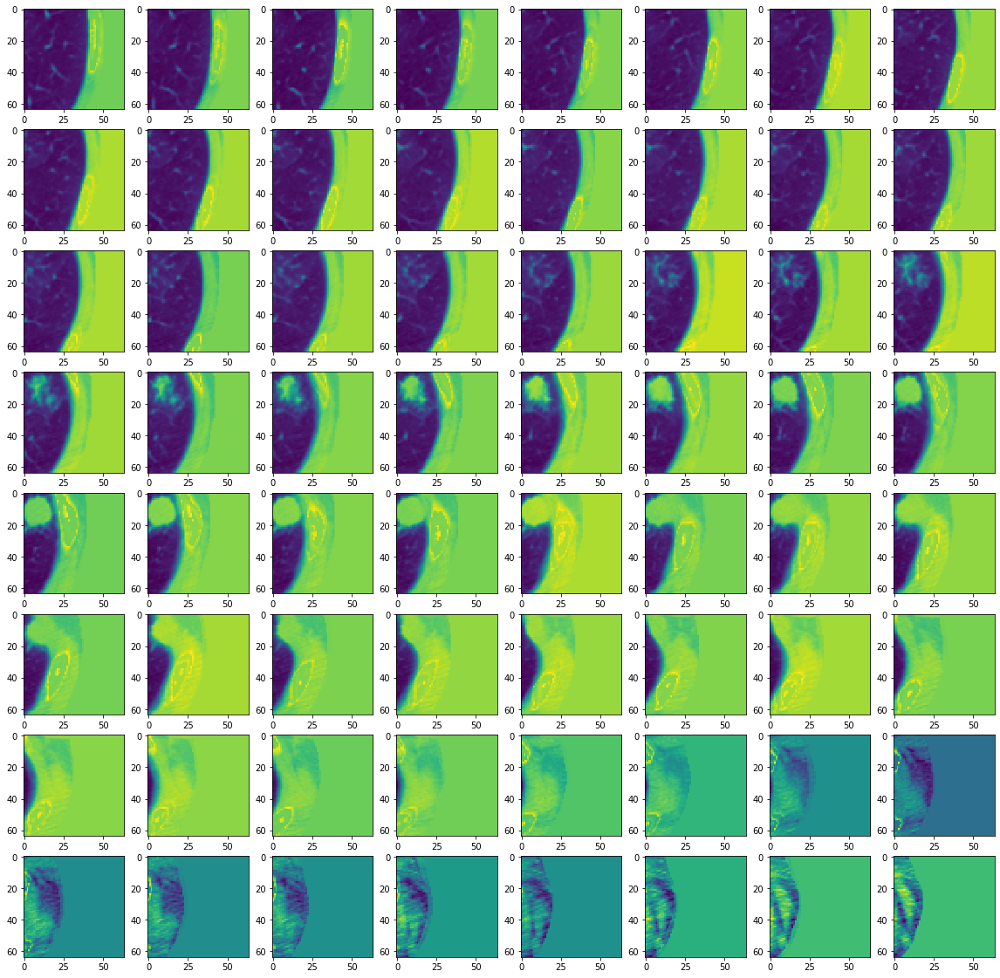

idx 55
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


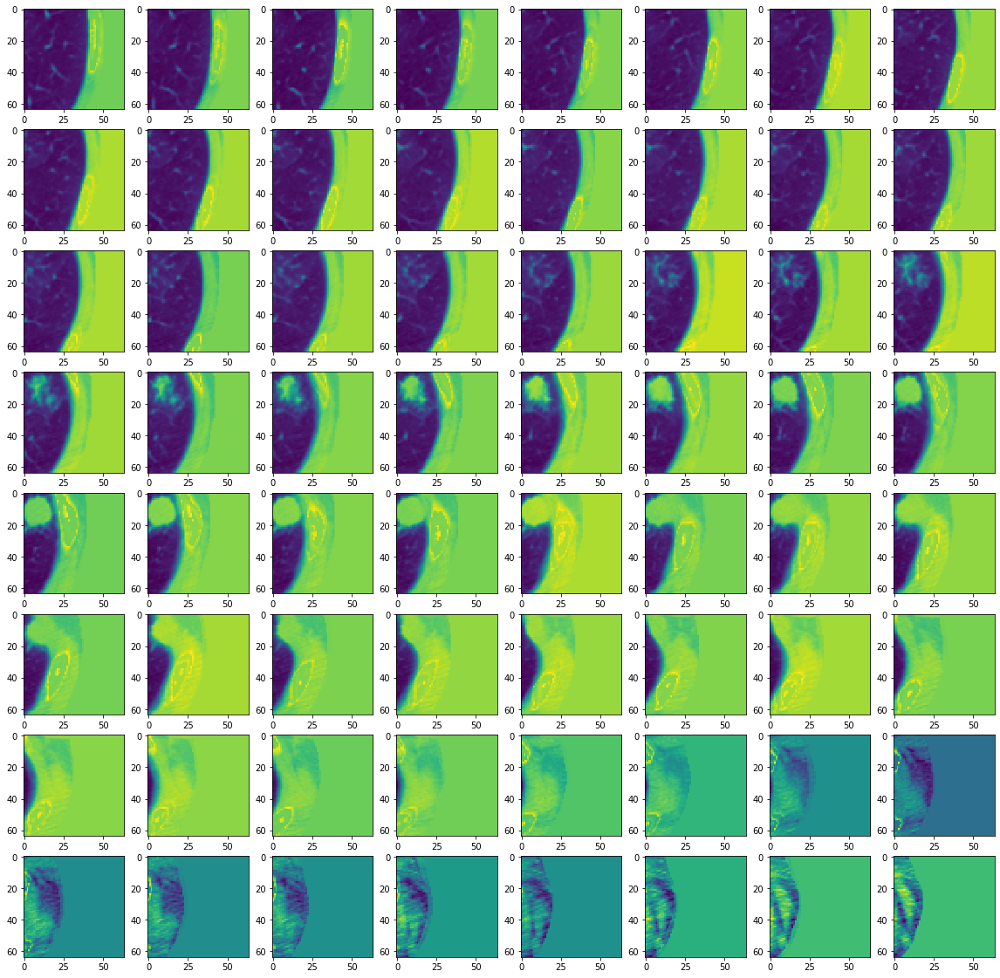

idx 56
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.18633747 26.004639    9.343524    9.597793   11.001238  ]
 [ 0.43953514 29.147058    9.4773445   9.358787   12.102508  ]
 [ 0.08380461 28.987577    9.321454    8.967335   16.589186  ]
 [-0.08060551 29.272982   13.602933    9.456177   11.809135  ]
 [ 0.14869547 29.31688    13.30248     9.0719     17.262651  ]
 [-0.07730675 33.126053   13.5972805   9.176247   11.475444  ]
 [ 0.93680096 32.796196   13.464002    8.644577   17.22472   ]]


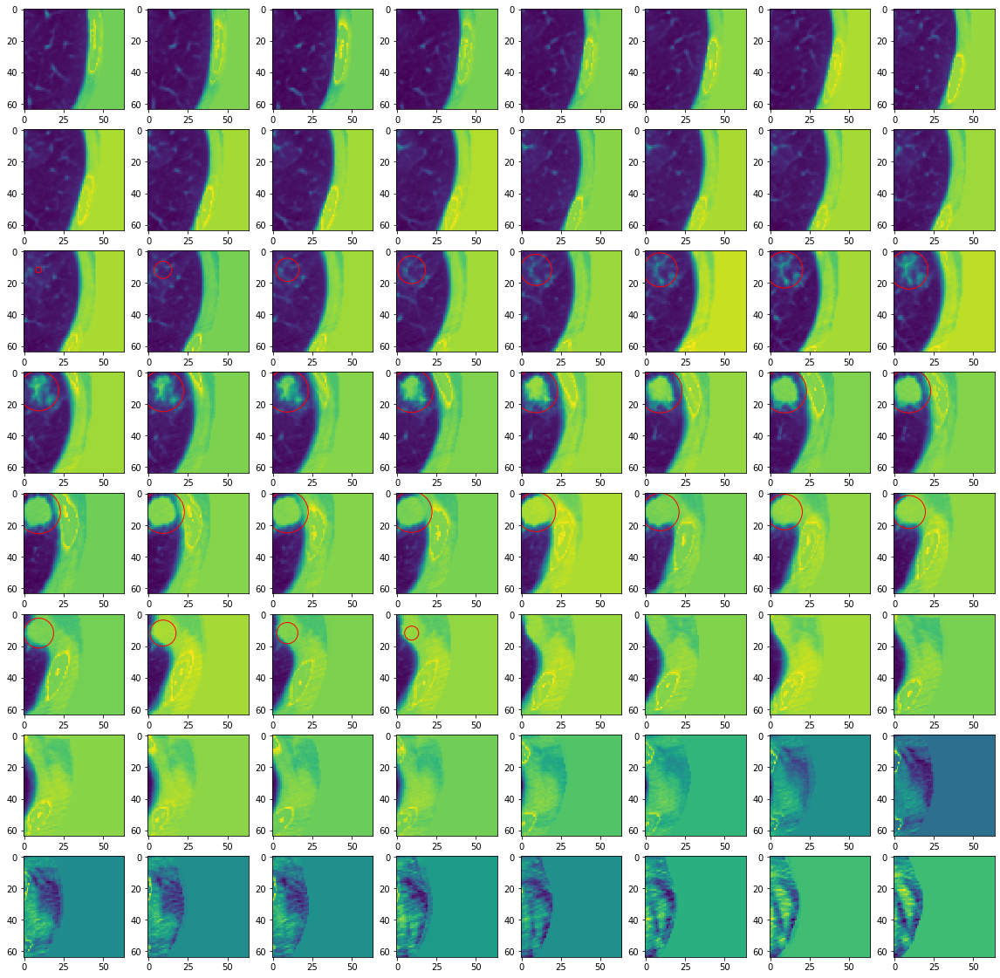

idx 57
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.3867402 29.61472   13.628035   9.213239  11.267329 ]
 [-0.3267727 32.846107  13.540928   8.870267  17.24363  ]]


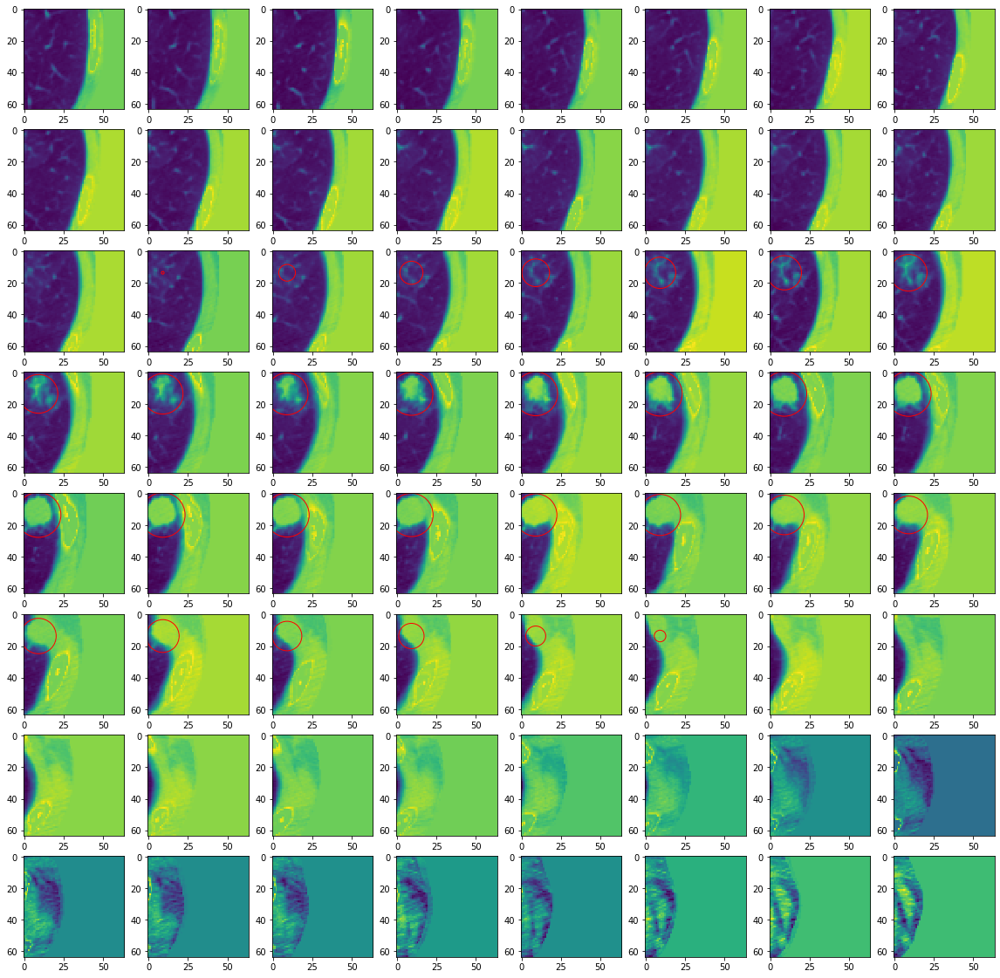

idx 58
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


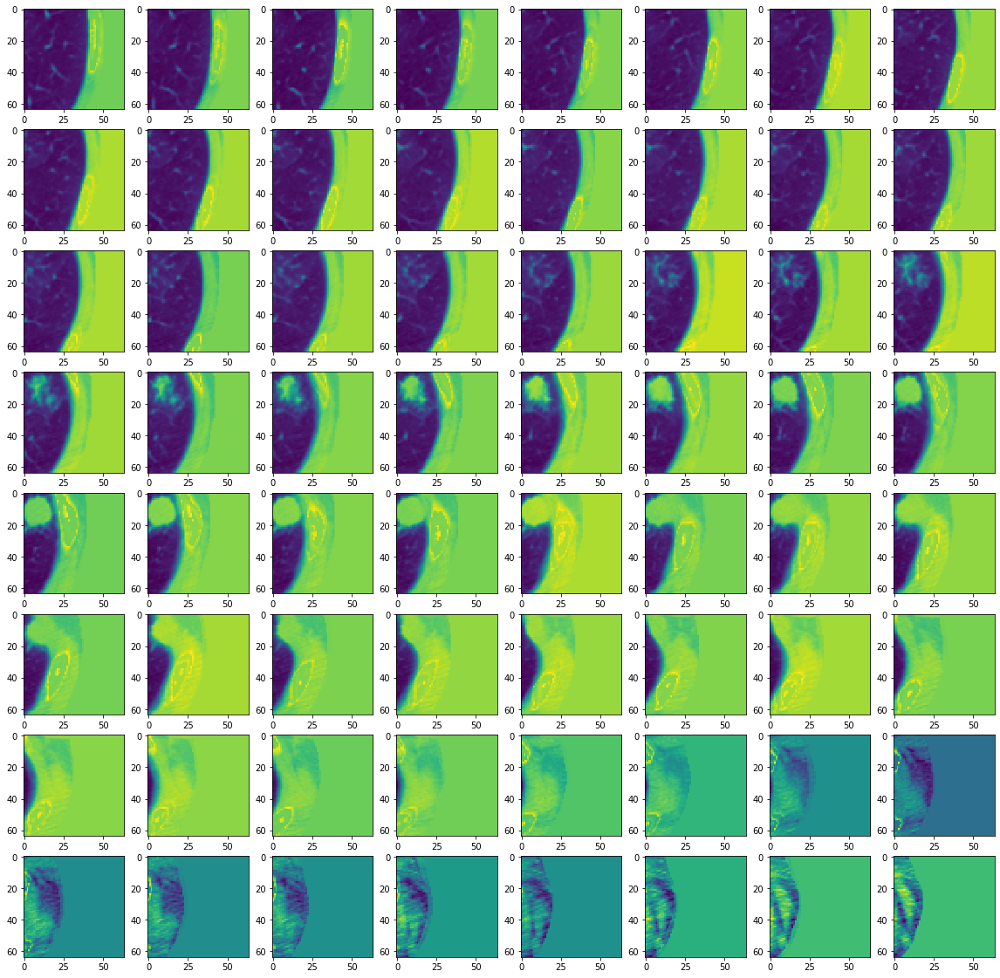

idx 59
start [240, 110, 240]
crop (1, 64, 64, 64)
!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[ 0.23511124 29.2751      9.431301    9.553714   12.128573  ]
 [ 0.2582121  29.256292    9.1360235   9.109536   16.662277  ]
 [-0.1111722  29.495436   13.536307    9.769499   11.546458  ]
 [ 0.38841248 29.56086    13.096914    9.238243   17.296082  ]
 [-0.2770567  33.064926   13.821178    9.628657   11.755203  ]
 [ 0.44021606 32.970688   12.960901    8.793523   17.50286   ]]


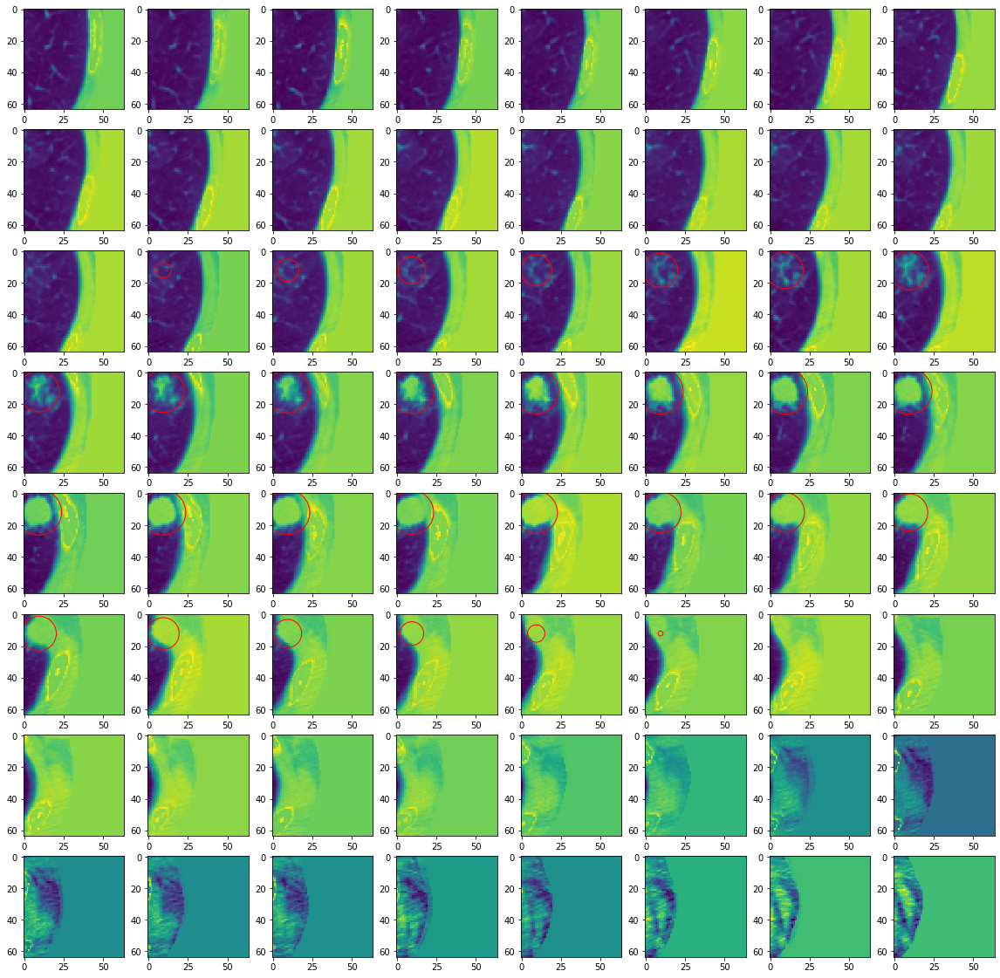

!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred []


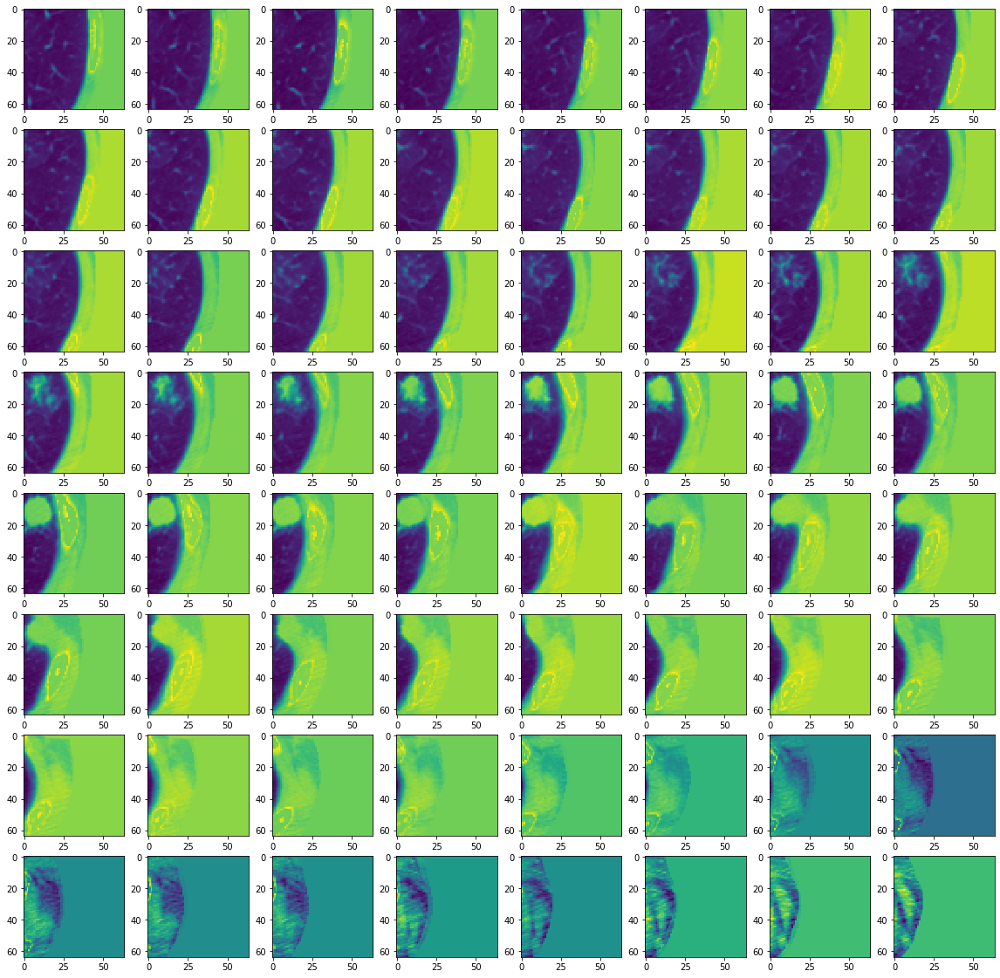

!!!! torch.Size([1, 1, 64, 64, 64]) torch.Size([1, 3, 16, 16, 16])
pred [[-0.35309982 29.645626   13.710193    9.613513   11.486671  ]
 [-0.40809655 29.662098   13.255154    9.147438   17.393137  ]
 [ 0.03779984 33.5744     13.832653    9.51129    11.634196  ]
 [-0.1701045  33.418423   13.4893055   9.103871   17.621437  ]]


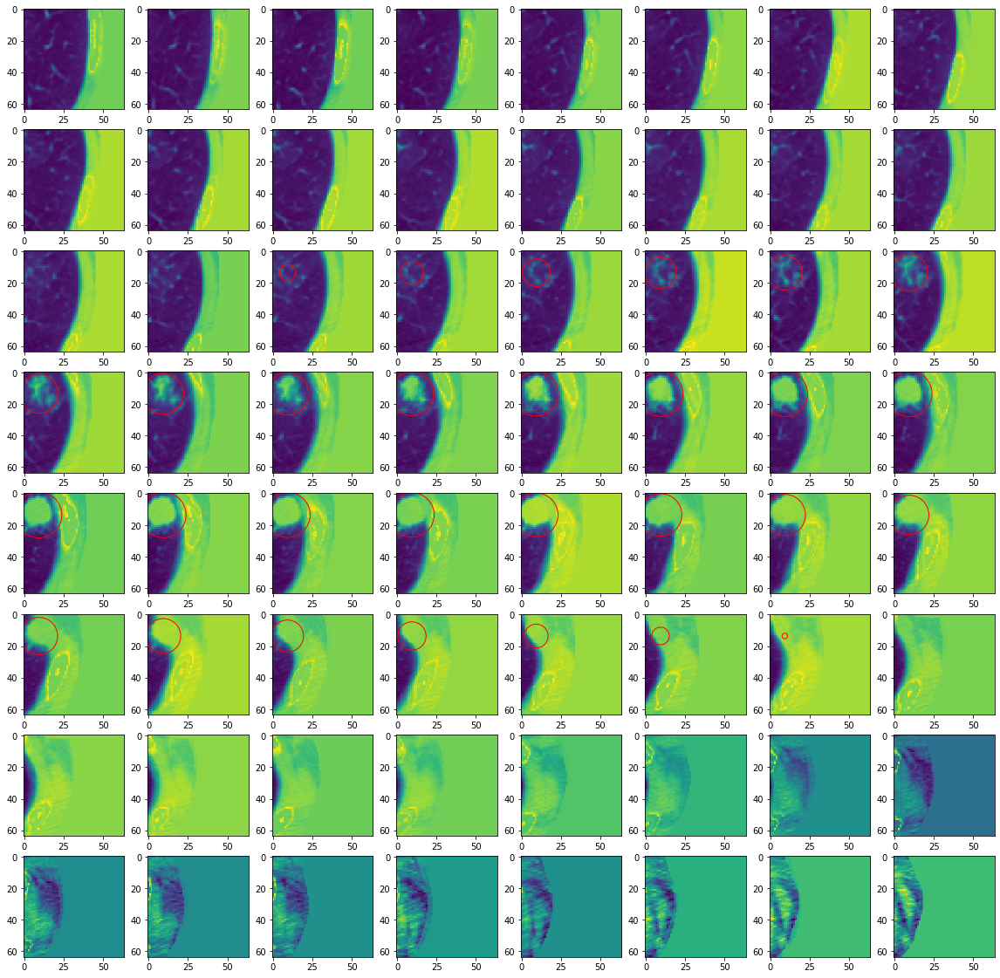

In [2]:
imgs = np.load("/home/pulyanov/projects/KT/KT_ITMO/3D/luna_detector/data/preprocess-result-path/010_clean.npy")
test_img(imgs)


(1, 128, 128, 128)
[[271.25274922 121.82526014 248.3557924   21.08961863]]


IndexError: index 290 is out of bounds for axis 1 with size 290

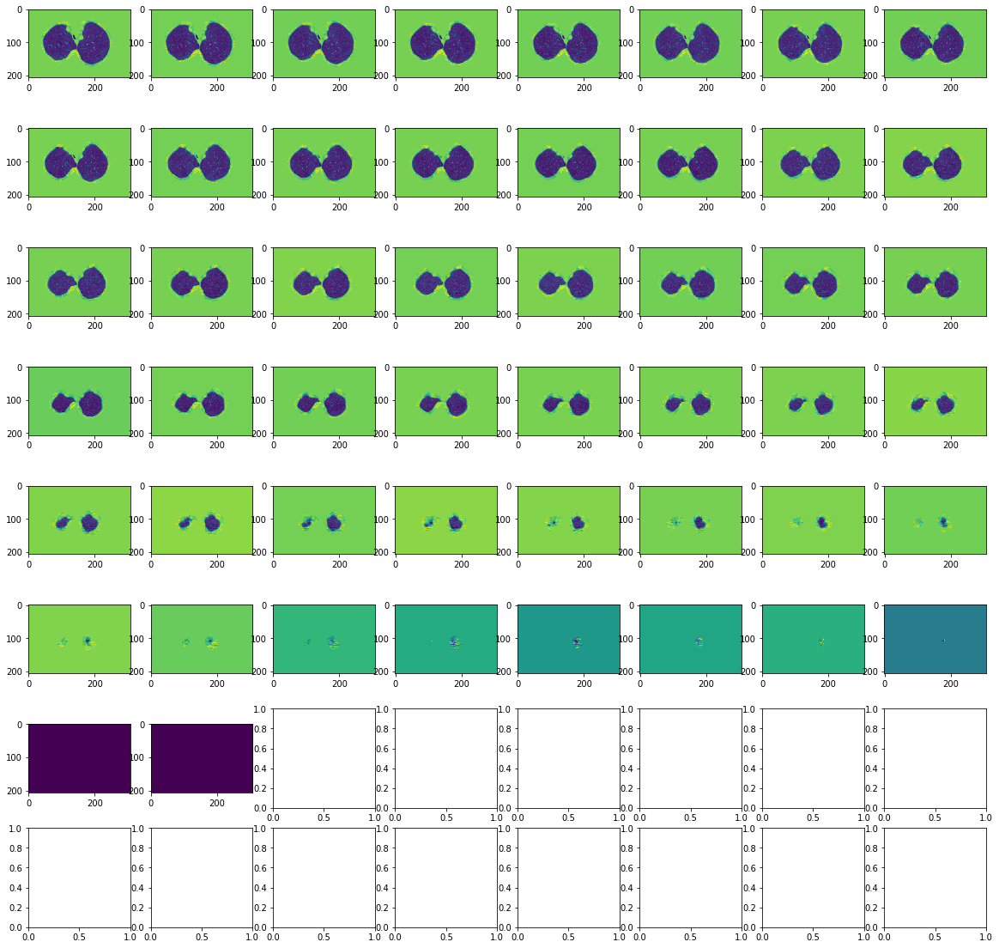

In [3]:
#crop mask
start = [140, 10, 140]
crop_size = [128, 128, 128]

label = np.load("/home/pulyanov/projects/KT/KT_ITMO/3D/luna_detector/data/preprocess-result-path/010_label.npy")
imgs = np.load("/home/pulyanov/projects/KT/KT_ITMO/3D/luna_detector/data/preprocess-result-path/360_clean.npy")

crop = imgs[:, max(start[0], 0):min(start[0] + crop_size[0], imgs.shape[1]),
       max(start[1], 0):min(start[1] + crop_size[1], imgs.shape[2]),
       max(start[2], 0):min(start[2] + crop_size[2], imgs.shape[3])
       ]


print(crop.shape)
print(label)

zPlane = 240
fig,ax = plt.subplots(8, 8, figsize=(20,20))
for i in range (8):
    for k in range (8):
        ax[i, k].imshow(imgs[0, zPlane, :, :])
        zPlane += 1

plt.show()





   